In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
# --- CELL 1: LIBRARIES ---
print("🚀 Step 1: Installing libraries...")
!pip install numpy<2 opencv-python==4.8.0.76 timm albumentations grad-cam -q
# Install PyTorch Geometric
!pip install torch_geometric pyg_lib torch_scatter torch_sparse torch_cluster torch_spline_conv -f https://data.pyg.org/whl/torch-2.0.0+cu118.html -q

import os
import cv2
import math
import random
import gc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from torch.cuda.amp import autocast, GradScaler
import albumentations as A
from albumentations.pytorch import ToTensorV2
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import cohen_kappa_score, accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
import timm
from torch_geometric.nn import GATConv
import networkx as nx
import warnings
warnings.filterwarnings("ignore")

print("✅ Libraries installed & imported.")

🚀 Step 1: Installing libraries...
/bin/bash: line 1: 2: No such file or directory
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 40.1 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 116.0 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 70.7 MB/s eta 0:00:00:00:010:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 72.0 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 886.5/886.5 kB 48.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 31.2 MB/s eta 0:00:0000:01


/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'repr' attribute with value False was provided to the `Field()` function, which has no effect in the context it was used. 'repr' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` statement was used, or if the `Field()` function was attached to a single member of a union type.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'frozen' attribute with value True was provided to the `Field()` function, which has no effect in the context it was used. 'frozen' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` 

✅ Libraries installed & imported.


In [2]:
# --- CELL 2: CONFIGURATION ---
def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

seed_everything(42)

class CFG:
    IMG_SIZE = 224
    BATCH_SIZE = 8
    LR = 1e-4
    EPOCHS = 30
    SEED = 42
    NUM_CLASSES = 4
    DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    N_SPLITS = 3
    DATA_DIR = "/kaggle/input/mri-dataset-224/MRI_T2_224_Combined" # Update path if needed

print(f"✅ Config ready on {CFG.DEVICE}")

✅ Config ready on cuda


In [3]:
# --- CELL 3 (FIXED): DATA PREPARATION + HOLD-OUT TEST SPLIT ---

from sklearn.model_selection import train_test_split
from glob import glob
import os
import pandas as pd
import numpy as np

class_map = {"F0": 0, "F1": 1, "F2": 2, "F3": 3}
image_paths, labels = [], []

for folder, label in class_map.items():
    folder_path = os.path.join(CFG.DATA_DIR, folder)
    imgs = glob(os.path.join(folder_path, "*.png"))
    image_paths.extend(imgs)
    labels.extend([label] * len(imgs))

df = pd.DataFrame({"image_path": image_paths, "diagnosis": labels})
df = df.sample(frac=1, random_state=CFG.SEED).reset_index(drop=True)

print(f"✅ Total images: {len(df)}")
print("Class distribution (all):")
print(df["diagnosis"].value_counts().sort_index())

# ✅ Hold-out test split (STRATIFIED)
train_df, test_df = train_test_split(
    df,
    test_size=0.20,                # 20% test
    stratify=df["diagnosis"],
    random_state=CFG.SEED
)
train_df = train_df.reset_index(drop=True)
test_df  = test_df.reset_index(drop=True)

print("\n✅ Hold-out split done.")
print(f"Train size: {len(train_df)} | Test size: {len(test_df)}")
print("Train distribution:")
print(train_df["diagnosis"].value_counts().sort_index())
print("Test distribution:")
print(test_df["diagnosis"].value_counts().sort_index())

# ✅ CV will run on train_df only
skf = StratifiedKFold(n_splits=CFG.N_SPLITS, shuffle=True, random_state=CFG.SEED)
splits = list(skf.split(train_df, train_df["diagnosis"]))
print(f"\n✅ {CFG.N_SPLITS}-fold CV splits created on train_df.")


✅ Total images: 10854
Class distribution (all):
diagnosis
0    2185
1    3280
2    3483
3    1906
Name: count, dtype: int64

✅ Hold-out split done.
Train size: 8683 | Test size: 2171
Train distribution:
diagnosis
0    1748
1    2624
2    2786
3    1525
Name: count, dtype: int64
Test distribution:
diagnosis
0    437
1    656
2    697
3    381
Name: count, dtype: int64

✅ 3-fold CV splits created on train_df.


In [4]:
# --- CELL 4: PREPROCESSING ---
def preprocess_for_model(path):
    img = cv2.imread(path)
    if img is None: return np.zeros((CFG.IMG_SIZE, CFG.IMG_SIZE, 3), dtype=np.uint8)
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # 1. Denoise
    img = cv2.medianBlur(img, 3)
    
    # 2. CLAHE (Contrast)
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l = clahe.apply(l)
    img = cv2.cvtColor(cv2.merge((l, a, b)), cv2.COLOR_LAB2RGB)
    
    # 3. Sharpen (Critical for texture)
    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    img = cv2.filter2D(img, -1, kernel)
    
    return img

print("✅ Preprocessing pipeline defined.")

✅ Preprocessing pipeline defined.


In [5]:
# --- CELL 5: DATASET ---
MEAN = [0.485, 0.456, 0.406]
STD  = [0.229, 0.224, 0.225]

train_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Rotate(limit=15, p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.2),
    A.RandomBrightnessContrast(p=0.2),
    A.Normalize(mean=MEAN, std=STD),
    ToTensorV2()
])

valid_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Normalize(mean=MEAN, std=STD),
    ToTensorV2()
])

class LiverDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df
        self.transform = transform

    def __len__(self): return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img = preprocess_for_model(row.image_path)
        if self.transform: img = self.transform(image=img)["image"]
        return img, torch.tensor(int(row.diagnosis), dtype=torch.long)

print("✅ Dataset class ready.")

✅ Dataset class ready.


🚀 Generaring High-Res Preprocessing Visualization (Cell 4 Logic)...

🖼️ Selected Image: /kaggle/input/mri-dataset-224/MRI_T2_224_Combined/F1/458_t2_slice030.png
🩺 True Diagnosis: F1


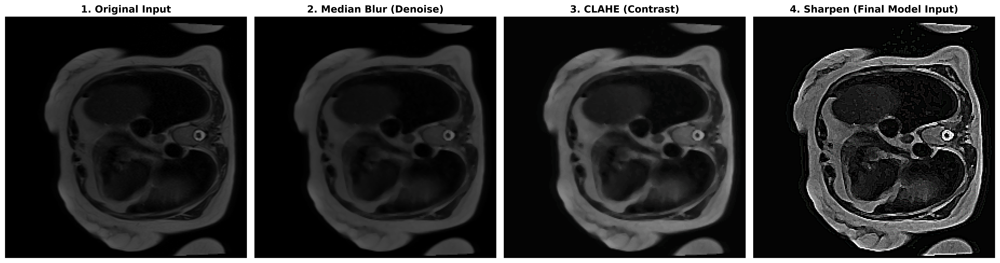

✅ Visualization Complete.


In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

# ==========================================
# High-Resolution Preprocessing Visualization
# ==========================================
print("🚀 Generaring High-Res Preprocessing Visualization (Cell 4 Logic)...")

def visualize_cell4_preprocessing(path):
    # 1. Load Image
    img = cv2.imread(path)
    if img is None:
        print(f"❌ Could not load: {path}")
        return

    # Convert BGR -> RGB (Original)
    img_orig = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # ----------------------------------------
    # Step 1: Denoise (Median Blur)
    # ----------------------------------------
    img_denoised = cv2.medianBlur(img_orig, 3)
    
    # ----------------------------------------
    # Step 2: CLAHE (Contrast in LAB space)
    # ----------------------------------------
    lab = cv2.cvtColor(img_denoised, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l = clahe.apply(l)
    img_clahe = cv2.cvtColor(cv2.merge((l, a, b)), cv2.COLOR_LAB2RGB)
    
    # ----------------------------------------
    # Step 3: Sharpen (Texture enhancement)
    # ----------------------------------------
    kernel = np.array([[-1,-1,-1], 
                       [-1, 9,-1], 
                       [-1,-1,-1]])
    img_sharp = cv2.filter2D(img_clahe, -1, kernel)
    
    # ==========================================
    # Plotting (DPI=600 for High Quality)
    # ==========================================
    fig, axes = plt.subplots(1, 4, figsize=(20, 6), dpi=600)
    
    steps = [
        ("1. Original Input", img_orig),
        ("2. Median Blur (Denoise)", img_denoised),
        ("3. CLAHE (Contrast)", img_clahe),
        ("4. Sharpen (Final Model Input)", img_sharp)
    ]

    for ax, (title, image) in zip(axes, steps):
        ax.imshow(image)
        ax.set_title(title, fontsize=14, fontweight='bold')
        ax.axis('off')

    plt.tight_layout()
    plt.show()
    print("✅ Visualization Complete.")

# ==========================================
# Run on a Random Image
# ==========================================
# Automatically find your dataframe
target_df = None
if 'df' in locals(): target_df = df
elif 'train_val_df' in locals(): target_df = train_val_df
elif 'test_df' in locals(): target_df = test_df

if target_df is not None and len(target_df) > 0:
    # Pick a random image
    rand_row = target_df.sample(1).iloc[0]
    img_path = rand_row['image_path']
    diagnosis = rand_row['diagnosis']
    
    print(f"\n🖼️ Selected Image: {img_path}")
    print(f"🩺 True Diagnosis: F{diagnosis}")
    
    visualize_cell4_preprocessing(img_path)
else:
    print("⚠️ No DataFrame found. Please set 'img_path' manually below:")
    # manual_path = "/path/to/image.jpg"
    # visualize_cell4_preprocessing(manual_path)

In [7]:
# --- CELL 6 (FIXED): DENSENET + GRID GAT MODEL (5-NEIGHBOUR) SAFE CACHING ---

class DenseNetGridGAT(nn.Module):
    def __init__(self, num_classes=4):
        super().__init__()

        # 1) Backbone: DenseNet121
        self.cnn = timm.create_model(
            "densenet121",
            pretrained=True,
            num_classes=0,
            global_pool=""
        )
        in_ch = self.cnn.num_features  # 1024

        # 2) GAT Layers
        self.gat1 = GATConv(in_ch, 256, heads=4, concat=True, dropout=0.2)     # out: 256*4=1024
        self.gat2 = GATConv(1024, 256, heads=1, concat=False, dropout=0.2)     # out: 256

        self.fc = nn.Linear(256, num_classes)

        # ✅ cache ONLY base edge for (H,W) single-image grid
        self.base_edge_index = None
        self.cached_hw = None

        # for XAI (optional)
        self.last_att = None

    def _build_base_edges(self, H, W, device):
        """
        Build base 5-neighbour grid edge_index for ONE image (N=H*W nodes).
        Neighbours: up, down, left, right, top-left diagonal
        """
        N = H * W
        r, c = torch.meshgrid(torch.arange(H, device=device),
                              torch.arange(W, device=device),
                              indexing="ij")
        r = r.flatten()
        c = c.flatten()

        offsets = torch.tensor([
            [-1,  0],  # up
            [ 1,  0],  # down
            [ 0, -1],  # left
            [ 0,  1],  # right
            [-1, -1],  # top-left diagonal
        ], device=device)

        src_list, dst_list = [], []
        for i in range(N):
            cr, cc = r[i].item(), c[i].item()
            for off in offsets:
                nr = cr + int(off[0].item())
                nc = cc + int(off[1].item())
                if 0 <= nr < H and 0 <= nc < W:
                    src_list.append(i)
                    dst_list.append(nr * W + nc)

        base_src = torch.tensor(src_list, device=device, dtype=torch.long)
        base_dst = torch.tensor(dst_list, device=device, dtype=torch.long)

        base_edge_index = torch.stack([base_src, base_dst], dim=0)  # [2, E]
        return base_edge_index

    def _expand_edges_for_batch(self, base_edge_index, B, N, device):
        """
        Expand base edges to a batched edge_index (B graphs, disjoint union).
        """
        E = base_edge_index.size(1)
        # repeat edges B times
        edge = base_edge_index.unsqueeze(0).repeat(B, 1, 1)  # [B, 2, E]

        # add node offsets per batch: (0, N, 2N, ...)
        offsets = (torch.arange(B, device=device, dtype=torch.long) * N).view(B, 1, 1)
        edge = edge + offsets

        # merge batch dimension
        edge = edge.permute(1, 0, 2).contiguous().view(2, B * E)  # [2, B*E]
        return edge

    def forward(self, x):
        feat = self.cnn.forward_features(x)   # [B,C,H,W]
        B, C, H, W = feat.shape
        N = H * W

        x_nodes = feat.permute(0, 2, 3, 1).contiguous().view(B * N, C)  # [B*N, C]

        # ✅ build base edges ONLY when (H,W) changes
        if self.base_edge_index is None or self.cached_hw != (H, W):
            self.base_edge_index = self._build_base_edges(H, W, x.device)
            self.cached_hw = (H, W)

        # ✅ expand edges EVERY forward to match current B
        edge_index = self._expand_edges_for_batch(self.base_edge_index, B, N, x.device)

        # GAT layers
        x_gat, (edge_idx1, alpha1) = self.gat1(x_nodes, edge_index, return_attention_weights=True)
        x_gat = F.elu(x_gat)

        x_gat, (edge_idx2, alpha2) = self.gat2(x_gat, edge_idx1, return_attention_weights=True)
        x_gat = F.relu(x_gat)

        # global pooling
        x_out = x_gat.view(B, N, -1).mean(dim=1)

        # store attention for XAI
        self.last_att = (edge_idx2, alpha2, B, H, W)

        return self.fc(x_out)

print("✅ DenseNet + Grid GAT (5-Neighbour) Model FIXED (safe batching).")


✅ DenseNet + Grid GAT (5-Neighbour) Model FIXED (safe batching).


In [8]:
# --- CELL 7 (FIXED): UTILS + HOLD-OUT TEST SPLIT + CV SPLITS ON TRAIN ONLY ---

from sklearn.model_selection import StratifiedKFold, train_test_split

print("✅ Building held-out test set + CV splits (NO leakage)...")

# ----------------------------
# 1) Create HOLD-OUT test_df
# ----------------------------
TEST_SIZE = 0.20  # 20% test split (you can change to 0.15 or 0.10 if needed)

train_df, test_df = train_test_split(
    df,
    test_size=TEST_SIZE,
    stratify=df["diagnosis"],
    random_state=CFG.SEED
)

train_df = train_df.reset_index(drop=True)
test_df  = test_df.reset_index(drop=True)

print(f"✅ train_df: {len(train_df)} images")
print(f"✅ test_df : {len(test_df)} images")

print("\nClass distribution (train_df):")
print(train_df["diagnosis"].value_counts().sort_index())
print("\nClass distribution (test_df):")
print(test_df["diagnosis"].value_counts().sort_index())

# ----------------------------
# 2) CV splits ONLY on train_df
# ----------------------------
skf = StratifiedKFold(n_splits=CFG.N_SPLITS, shuffle=True, random_state=CFG.SEED)
splits = list(skf.split(train_df, train_df["diagnosis"]))

print(f"\n✅ Created {CFG.N_SPLITS}-fold splits on train_df (safe).")


✅ Building held-out test set + CV splits (NO leakage)...
✅ train_df: 8683 images
✅ test_df : 2171 images

Class distribution (train_df):
diagnosis
0    1748
1    2624
2    2786
3    1525
Name: count, dtype: int64

Class distribution (test_df):
diagnosis
0    437
1    656
2    697
3    381
Name: count, dtype: int64

✅ Created 3-fold splits on train_df (safe).


In [10]:
# --- CELL 8 (FULL FIXED): TRAINING LOOP (DenseNet + Grid GAT) ---

import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, WeightedRandomSampler
from torch.cuda.amp import autocast, GradScaler
from tqdm import tqdm
from sklearn.metrics import cohen_kappa_score, accuracy_score

print("🚀 Starting training: DenseNet + Grid GAT (MRI)")

# ✅ Safety checks
if "train_df" not in globals():
    raise NameError("❌ train_df not found. Make sure your CELL 3 creates train_df and test_df.")
if "splits" not in globals():
    raise NameError("❌ splits not found. Make sure splits are created using train_df (not df).")
if "DenseNetGridGAT" not in globals():
    raise NameError("❌ DenseNetGridGAT not found. Run the FIXED GAT model cell first.")
if "LiverDataset" not in globals():
    raise NameError("❌ LiverDataset not found. Run dataset cell first.")
if "train_tfms" not in globals() or "valid_tfms" not in globals():
    raise NameError("❌ train_tfms/valid_tfms not found. Run transforms cell first.")

# ----------------------------
# Focal Loss (define here so no NameError)
# ----------------------------
class FocalLoss(nn.Module):
    def __init__(self, alpha=1.0, gamma=2.0):
        super().__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.ce = nn.CrossEntropyLoss(reduction="none")

    def forward(self, inputs, targets):
        ce_loss = self.ce(inputs, targets)
        pt = torch.exp(-ce_loss)
        return (self.alpha * (1 - pt) ** self.gamma * ce_loss).mean()

# ----------------------------
# Helper: Weighted Sampler
# ----------------------------
def make_sampler(sub_df, label_col="diagnosis"):
    counts = sub_df[label_col].value_counts().to_dict()
    weights = [1.0 / counts[int(lbl)] for lbl in sub_df[label_col].values]
    return WeightedRandomSampler(weights, num_samples=len(weights), replacement=True)

# ----------------------------
# Train one fold
# ----------------------------
def train_fold(fold, train_idx, val_idx):
    print("\n==============================")
    print(f"🚀 FOLD {fold+1}/{CFG.N_SPLITS}")
    print("==============================")

    # ✅ indices must be from train_df
    train_sub = train_df.iloc[train_idx].reset_index(drop=True)
    val_sub   = train_df.iloc[val_idx].reset_index(drop=True)

    sampler = make_sampler(train_sub, label_col="diagnosis")

    train_loader = DataLoader(
        LiverDataset(train_sub, transform=train_tfms),
        batch_size=CFG.BATCH_SIZE,
        sampler=sampler,
        num_workers=2,
        pin_memory=True
        # NOTE: do NOT use drop_last here; fixed model supports variable batch sizes
    )

    val_loader = DataLoader(
        LiverDataset(val_sub, transform=valid_tfms),
        batch_size=CFG.BATCH_SIZE,
        shuffle=False,
        num_workers=2,
        pin_memory=True
    )

    model = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)

    optimizer = optim.AdamW(model.parameters(), lr=CFG.LR, weight_decay=1e-4)
    scaler = GradScaler()
    criterion = FocalLoss()
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode="max", patience=2, factor=0.5
    )

    best_qwk = -1.0
    best_path = f"gat_fold{fold+1}.pth"

    for epoch in range(1, CFG.EPOCHS + 1):
        # -------- TRAIN --------
        model.train()
        running_loss = 0.0

        pbar = tqdm(train_loader, desc=f"Train F{fold+1} Ep{epoch}", leave=False)
        for imgs, labels in pbar:
            imgs = imgs.to(CFG.DEVICE, non_blocking=True)
            labels = labels.to(CFG.DEVICE, non_blocking=True)

            optimizer.zero_grad(set_to_none=True)

            with autocast():
                out = model(imgs)
                loss = criterion(out, labels)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            running_loss += loss.item()
            pbar.set_postfix(loss=float(loss.item()))

        train_loss = running_loss / max(len(train_loader), 1)

        # -------- VALID --------
        model.eval()
        preds, trues = [], []

        with torch.no_grad():
            for imgs, labels in val_loader:
                imgs = imgs.to(CFG.DEVICE, non_blocking=True)
                labels = labels.to(CFG.DEVICE, non_blocking=True)

                with autocast():
                    out = model(imgs)

                preds.extend(out.argmax(1).detach().cpu().numpy())
                trues.extend(labels.detach().cpu().numpy())

        val_acc = accuracy_score(trues, preds)
        val_qwk = cohen_kappa_score(trues, preds, weights="quadratic")

        scheduler.step(val_qwk)

        print(
            f"Ep {epoch:02d}/{CFG.EPOCHS} | "
            f"Train Loss={train_loss:.4f} | "
            f"Val Acc={val_acc:.4f} | "
            f"Val QWK={val_qwk:.4f}"
        )

        if val_qwk > best_qwk:
            best_qwk = val_qwk
            torch.save(model.state_dict(), best_path)
            print(f"--> ⭐ Saved BEST fold {fold+1} @ {best_path} | QWK={best_qwk:.4f}")

    return best_qwk

# ----------------------------
# Run CV training
# ----------------------------
fold_scores = []
for i, (t_idx, v_idx) in enumerate(splits):
    score = train_fold(i, t_idx, v_idx)
    fold_scores.append(score)

print("\n✅ Training Done.")
print(f"📌 Fold QWKs: {[round(float(s), 4) for s in fold_scores]}")
print(f"📌 Avg QWK: {float(np.mean(fold_scores)):.4f}")
print("✅ Saved weights: gat_fold1.pth, gat_fold2.pth, gat_fold3.pth")


🚀 Starting training: DenseNet + Grid GAT (MRI)

🚀 FOLD 1/3


Ep 01/30 | Train Loss=0.5337 | Val Acc=0.5983 | Val QWK=0.6962
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.6962


Ep 02/30 | Train Loss=0.3444 | Val Acc=0.7188 | Val QWK=0.8029
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.8029


Ep 03/30 | Train Loss=0.2753 | Val Acc=0.7520 | Val QWK=0.8202
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.8202


Ep 04/30 | Train Loss=0.2217 | Val Acc=0.7917 | Val QWK=0.8525
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.8525


Ep 05/30 | Train Loss=0.1795 | Val Acc=0.8453 | Val QWK=0.8897
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.8897


Ep 06/30 | Train Loss=0.1555 | Val Acc=0.8421 | Val QWK=0.8875


Ep 07/30 | Train Loss=0.1295 | Val Acc=0.8473 | Val QWK=0.8858


Ep 08/30 | Train Loss=0.1158 | Val Acc=0.8736 | Val QWK=0.9076
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9076


Ep 09/30 | Train Loss=0.1081 | Val Acc=0.8812 | Val QWK=0.9190
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9190


Ep 10/30 | Train Loss=0.0912 | Val Acc=0.8933 | Val QWK=0.9210
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9210


Ep 11/30 | Train Loss=0.0907 | Val Acc=0.8974 | Val QWK=0.9271
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9271


Ep 12/30 | Train Loss=0.0815 | Val Acc=0.9199 | Val QWK=0.9425
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9425


Ep 13/30 | Train Loss=0.0728 | Val Acc=0.9026 | Val QWK=0.9225


Ep 14/30 | Train Loss=0.0720 | Val Acc=0.9161 | Val QWK=0.9408


Ep 15/30 | Train Loss=0.0686 | Val Acc=0.9064 | Val QWK=0.9331


Ep 16/30 | Train Loss=0.0415 | Val Acc=0.9554 | Val QWK=0.9657
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9657


Ep 17/30 | Train Loss=0.0332 | Val Acc=0.9568 | Val QWK=0.9698
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9698


Ep 18/30 | Train Loss=0.0303 | Val Acc=0.9461 | Val QWK=0.9560


Ep 19/30 | Train Loss=0.0262 | Val Acc=0.9492 | Val QWK=0.9646


Ep 20/30 | Train Loss=0.0288 | Val Acc=0.9572 | Val QWK=0.9665


Ep 21/30 | Train Loss=0.0175 | Val Acc=0.9724 | Val QWK=0.9800
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9800


Ep 22/30 | Train Loss=0.0137 | Val Acc=0.9751 | Val QWK=0.9839
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9839


Ep 23/30 | Train Loss=0.0142 | Val Acc=0.9720 | Val QWK=0.9768


Ep 24/30 | Train Loss=0.0133 | Val Acc=0.9699 | Val QWK=0.9785


Ep 25/30 | Train Loss=0.0137 | Val Acc=0.9665 | Val QWK=0.9735


Ep 26/30 | Train Loss=0.0115 | Val Acc=0.9775 | Val QWK=0.9837


Ep 27/30 | Train Loss=0.0110 | Val Acc=0.9786 | Val QWK=0.9832


Ep 28/30 | Train Loss=0.0079 | Val Acc=0.9782 | Val QWK=0.9817


Ep 29/30 | Train Loss=0.0093 | Val Acc=0.9820 | Val QWK=0.9871
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9871


Ep 30/30 | Train Loss=0.0049 | Val Acc=0.9817 | Val QWK=0.9873
--> ⭐ Saved BEST fold 1 @ gat_fold1.pth | QWK=0.9873

🚀 FOLD 2/3


Ep 01/30 | Train Loss=0.5005 | Val Acc=0.6182 | Val QWK=0.7192
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.7192


Ep 02/30 | Train Loss=0.3464 | Val Acc=0.6862 | Val QWK=0.7740
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.7740


Ep 03/30 | Train Loss=0.2795 | Val Acc=0.7367 | Val QWK=0.8084
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.8084


Ep 04/30 | Train Loss=0.2254 | Val Acc=0.8162 | Val QWK=0.8705
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.8705


Ep 05/30 | Train Loss=0.1845 | Val Acc=0.7837 | Val QWK=0.8377


Ep 06/30 | Train Loss=0.1564 | Val Acc=0.8473 | Val QWK=0.8742
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.8742


Ep 07/30 | Train Loss=0.1338 | Val Acc=0.8169 | Val QWK=0.8624


Ep 08/30 | Train Loss=0.1259 | Val Acc=0.8663 | Val QWK=0.9032
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9032


Ep 09/30 | Train Loss=0.1025 | Val Acc=0.8953 | Val QWK=0.9177
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9177


Ep 10/30 | Train Loss=0.0999 | Val Acc=0.8822 | Val QWK=0.9182
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9182


Ep 11/30 | Train Loss=0.0855 | Val Acc=0.8874 | Val QWK=0.9065


Ep 12/30 | Train Loss=0.0841 | Val Acc=0.9126 | Val QWK=0.9288
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9288


Ep 13/30 | Train Loss=0.0767 | Val Acc=0.9240 | Val QWK=0.9416
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9416


Ep 14/30 | Train Loss=0.0750 | Val Acc=0.8984 | Val QWK=0.9156


Ep 15/30 | Train Loss=0.0626 | Val Acc=0.9209 | Val QWK=0.9360


Ep 16/30 | Train Loss=0.0569 | Val Acc=0.8639 | Val QWK=0.8813


Ep 17/30 | Train Loss=0.0402 | Val Acc=0.9478 | Val QWK=0.9597
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9597


Ep 18/30 | Train Loss=0.0325 | Val Acc=0.9457 | Val QWK=0.9564


Ep 19/30 | Train Loss=0.0304 | Val Acc=0.9475 | Val QWK=0.9675
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9675


Ep 20/30 | Train Loss=0.0284 | Val Acc=0.9451 | Val QWK=0.9623


Ep 21/30 | Train Loss=0.0235 | Val Acc=0.9281 | Val QWK=0.9370


Ep 22/30 | Train Loss=0.0258 | Val Acc=0.9599 | Val QWK=0.9690
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9690


Ep 23/30 | Train Loss=0.0211 | Val Acc=0.9592 | Val QWK=0.9663


Ep 24/30 | Train Loss=0.0237 | Val Acc=0.9596 | Val QWK=0.9683


Ep 25/30 | Train Loss=0.0214 | Val Acc=0.9551 | Val QWK=0.9672


Ep 26/30 | Train Loss=0.0150 | Val Acc=0.9616 | Val QWK=0.9718
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9718


Ep 27/30 | Train Loss=0.0126 | Val Acc=0.9692 | Val QWK=0.9788
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9788


Ep 28/30 | Train Loss=0.0096 | Val Acc=0.9679 | Val QWK=0.9791
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9791


Ep 29/30 | Train Loss=0.0075 | Val Acc=0.9730 | Val QWK=0.9818
--> ⭐ Saved BEST fold 2 @ gat_fold2.pth | QWK=0.9818


Ep 30/30 | Train Loss=0.0131 | Val Acc=0.9675 | Val QWK=0.9763

🚀 FOLD 3/3


Ep 01/30 | Train Loss=0.5273 | Val Acc=0.6230 | Val QWK=0.7283
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.7283


Ep 02/30 | Train Loss=0.3636 | Val Acc=0.6966 | Val QWK=0.7937
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.7937


Ep 03/30 | Train Loss=0.2781 | Val Acc=0.7426 | Val QWK=0.8105
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.8105


Ep 04/30 | Train Loss=0.2311 | Val Acc=0.7678 | Val QWK=0.8495
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.8495


Ep 05/30 | Train Loss=0.1843 | Val Acc=0.7806 | Val QWK=0.8311


Ep 06/30 | Train Loss=0.1632 | Val Acc=0.8117 | Val QWK=0.8664
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.8664


Ep 07/30 | Train Loss=0.1425 | Val Acc=0.8314 | Val QWK=0.8593


Ep 08/30 | Train Loss=0.1307 | Val Acc=0.8639 | Val QWK=0.9024
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9024


Ep 09/30 | Train Loss=0.1122 | Val Acc=0.8525 | Val QWK=0.8943


Ep 10/30 | Train Loss=0.1055 | Val Acc=0.8939 | Val QWK=0.9178
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9178


Ep 11/30 | Train Loss=0.0979 | Val Acc=0.9053 | Val QWK=0.9321
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9321


Ep 12/30 | Train Loss=0.0832 | Val Acc=0.8874 | Val QWK=0.9048


Ep 13/30 | Train Loss=0.0903 | Val Acc=0.8766 | Val QWK=0.9031


Ep 14/30 | Train Loss=0.0772 | Val Acc=0.8956 | Val QWK=0.9247


Ep 15/30 | Train Loss=0.0495 | Val Acc=0.9413 | Val QWK=0.9529
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9529


Ep 16/30 | Train Loss=0.0346 | Val Acc=0.9475 | Val QWK=0.9602
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9602


Ep 17/30 | Train Loss=0.0389 | Val Acc=0.9451 | Val QWK=0.9589


Ep 18/30 | Train Loss=0.0311 | Val Acc=0.9471 | Val QWK=0.9566


Ep 19/30 | Train Loss=0.0281 | Val Acc=0.9537 | Val QWK=0.9642
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9642


Ep 20/30 | Train Loss=0.0262 | Val Acc=0.9547 | Val QWK=0.9628


Ep 21/30 | Train Loss=0.0275 | Val Acc=0.9592 | Val QWK=0.9637


Ep 22/30 | Train Loss=0.0314 | Val Acc=0.9375 | Val QWK=0.9430


Ep 23/30 | Train Loss=0.0191 | Val Acc=0.9634 | Val QWK=0.9639


Ep 24/30 | Train Loss=0.0160 | Val Acc=0.9651 | Val QWK=0.9668
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9668


Ep 25/30 | Train Loss=0.0128 | Val Acc=0.9679 | Val QWK=0.9691
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9691


Ep 26/30 | Train Loss=0.0157 | Val Acc=0.9627 | Val QWK=0.9631


Ep 27/30 | Train Loss=0.0169 | Val Acc=0.9679 | Val QWK=0.9667


Ep 28/30 | Train Loss=0.0113 | Val Acc=0.9727 | Val QWK=0.9760
--> ⭐ Saved BEST fold 3 @ gat_fold3.pth | QWK=0.9760


Ep 29/30 | Train Loss=0.0103 | Val Acc=0.9689 | Val QWK=0.9734


Ep 30/30 | Train Loss=0.0094 | Val Acc=0.9675 | Val QWK=0.9744

✅ Training Done.
📌 Fold QWKs: [0.9873, 0.9818, 0.976]
📌 Avg QWK: 0.9817
✅ Saved weights: gat_fold1.pth, gat_fold2.pth, gat_fold3.pth



📌 GAT + DenseNet (MRI): PER-FOLD (fold-model-on-test) + OVERALL (600 DPI)

🔹 Fold-model 1 on TEST set...
✅ Fold 1 TEST Accuracy: 0.9784
✅ Fold 1 TEST QWK:      0.9865


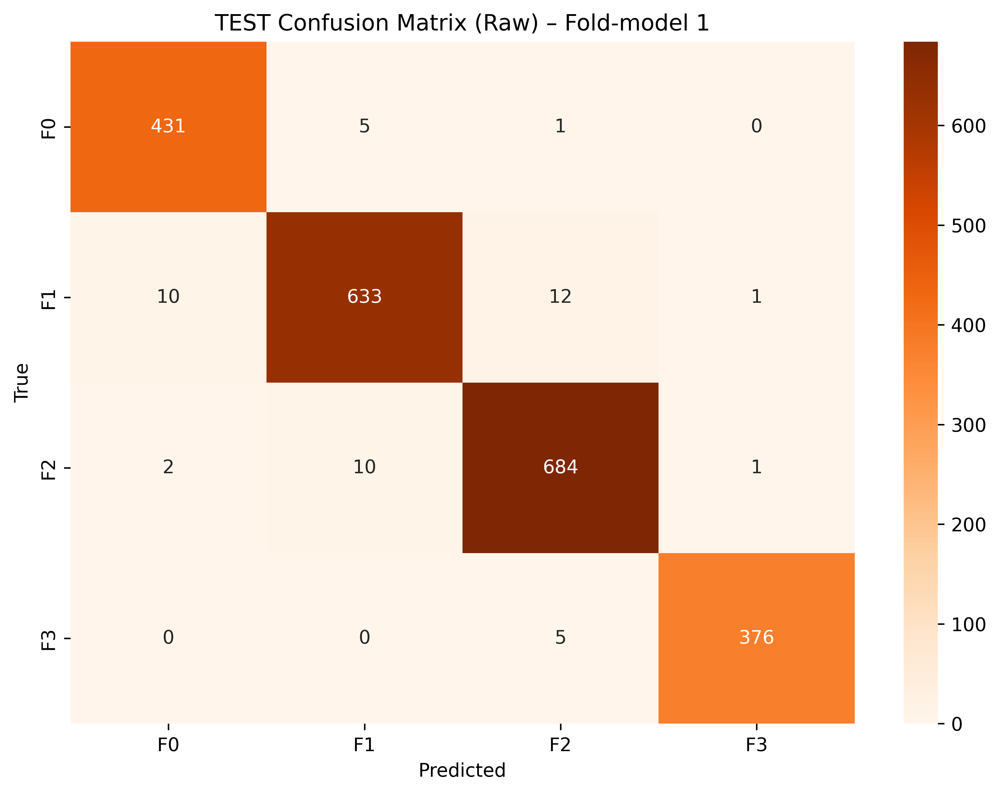

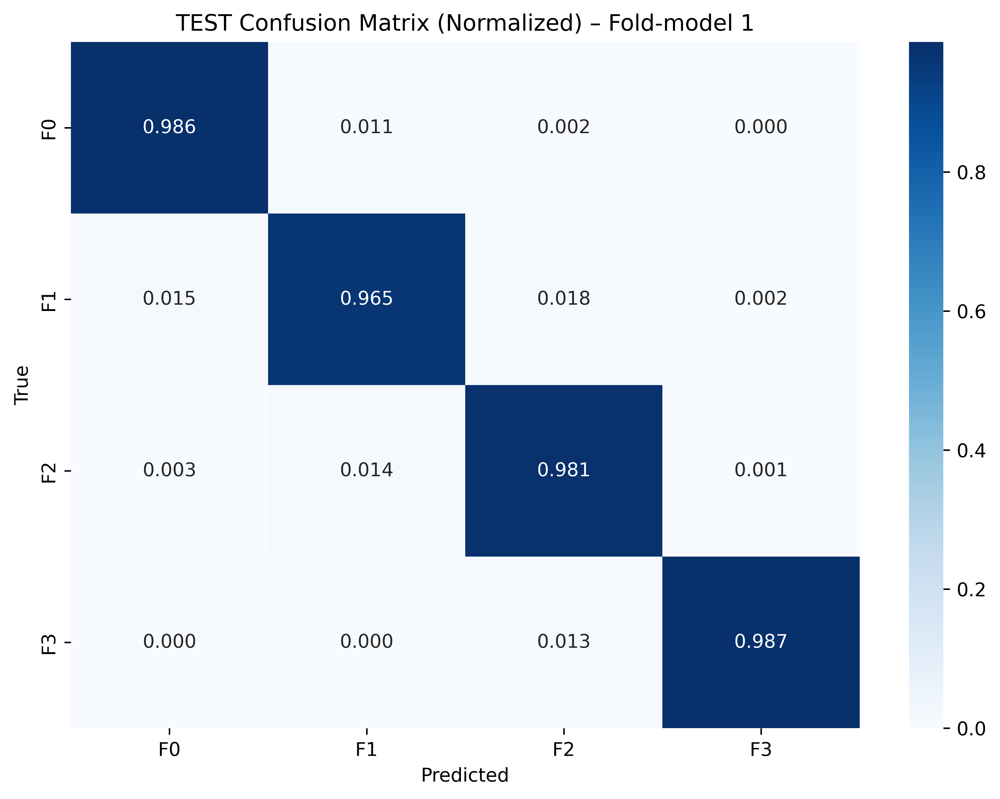


📄 Classification Report (Fold-model 1 on TEST):
              precision    recall  f1-score   support

          F0     0.9729    0.9863    0.9795       437
          F1     0.9769    0.9649    0.9709       656
          F2     0.9744    0.9813    0.9778       697
          F3     0.9947    0.9869    0.9908       381

    accuracy                         0.9784      2171
   macro avg     0.9797    0.9799    0.9798      2171
weighted avg     0.9784    0.9784    0.9783      2171


🔹 Fold-model 2 on TEST set...
✅ Fold 2 TEST Accuracy: 0.9641
✅ Fold 2 TEST QWK:      0.9756


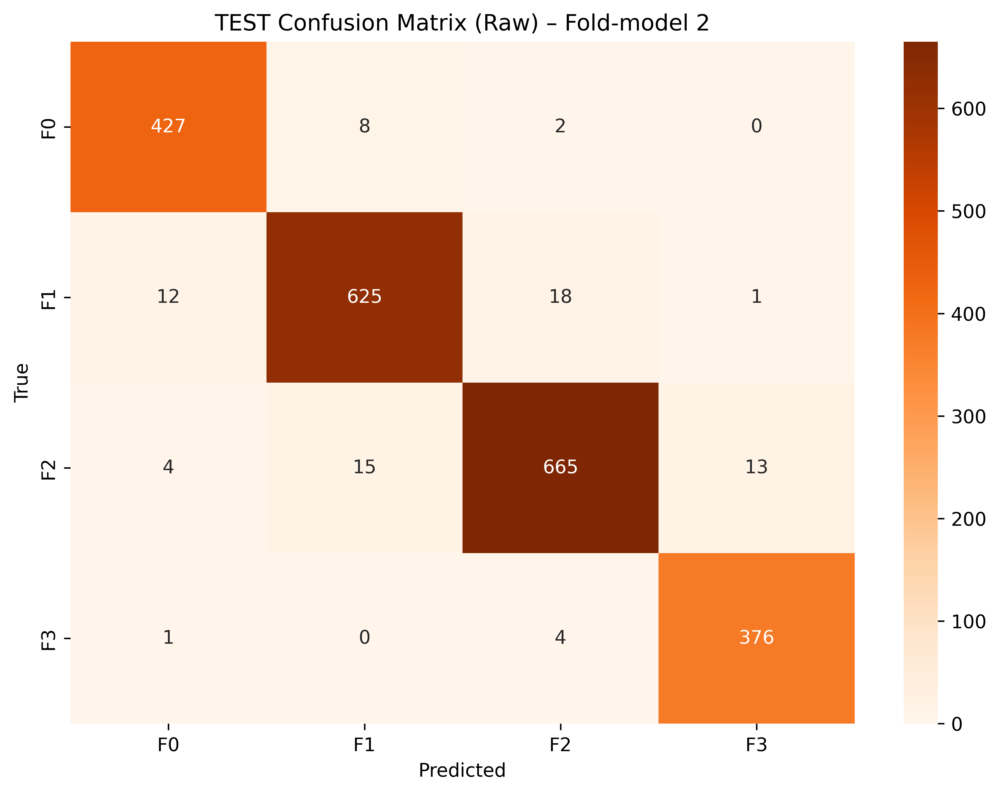

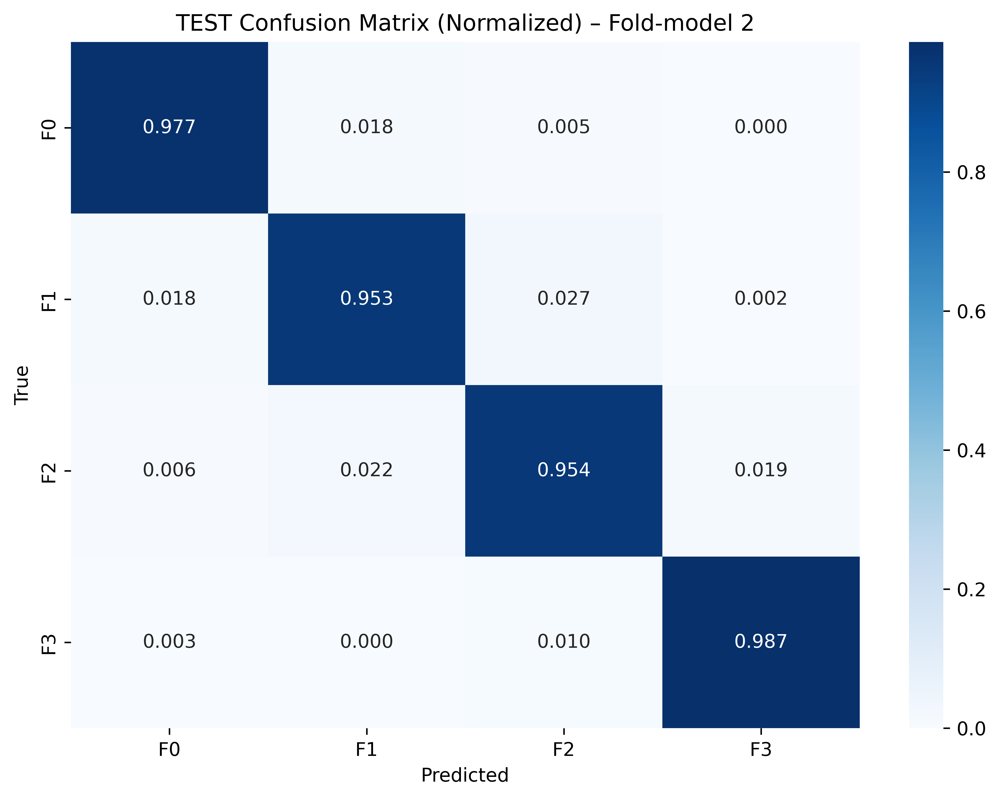


📄 Classification Report (Fold-model 2 on TEST):
              precision    recall  f1-score   support

          F0     0.9617    0.9771    0.9694       437
          F1     0.9645    0.9527    0.9586       656
          F2     0.9652    0.9541    0.9596       697
          F3     0.9641    0.9869    0.9754       381

    accuracy                         0.9641      2171
   macro avg     0.9639    0.9677    0.9657      2171
weighted avg     0.9641    0.9641    0.9640      2171


🔹 Fold-model 3 on TEST set...
✅ Fold 3 TEST Accuracy: 0.9696
✅ Fold 3 TEST QWK:      0.9760


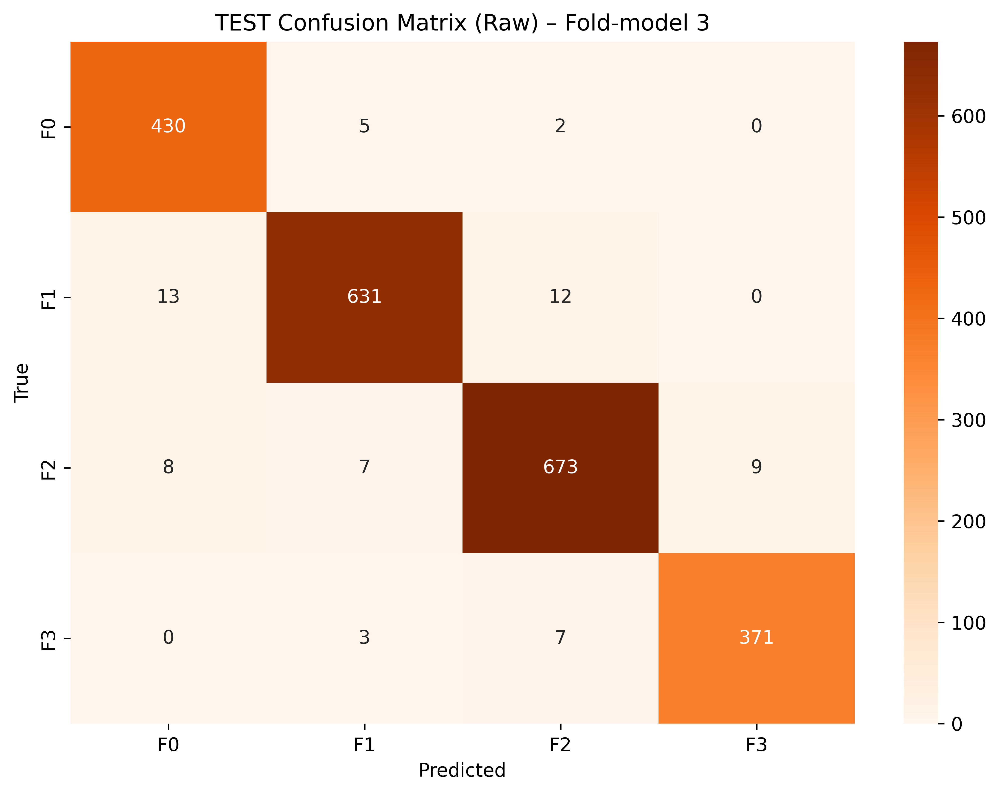

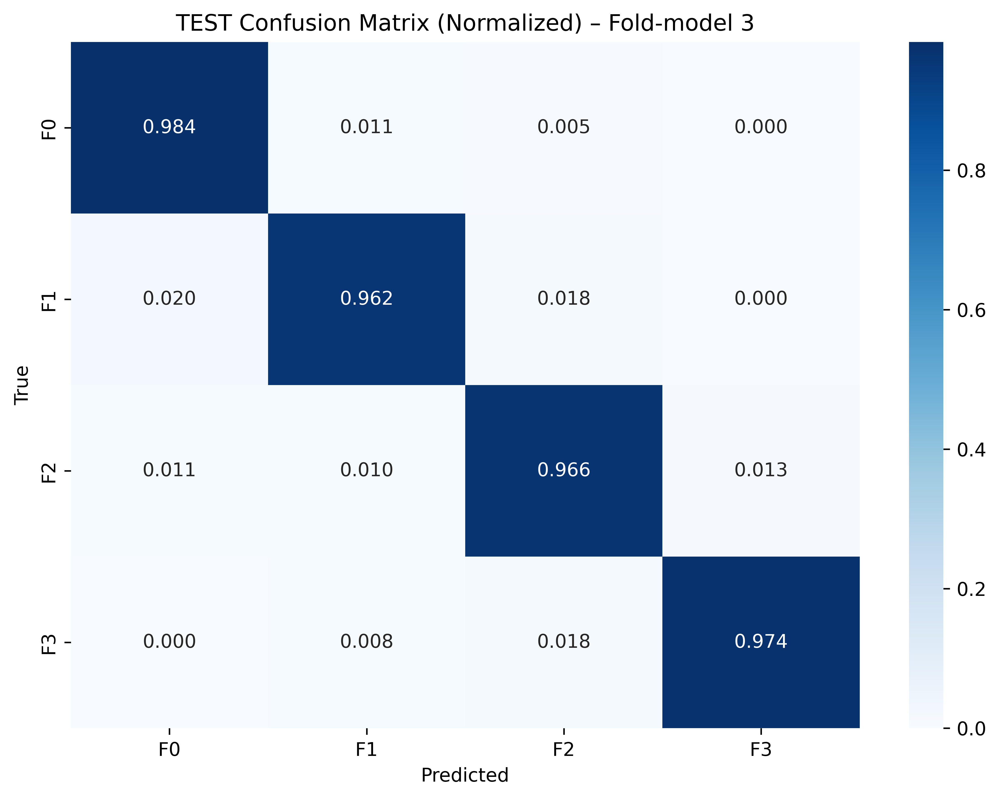


📄 Classification Report (Fold-model 3 on TEST):
              precision    recall  f1-score   support

          F0     0.9534    0.9840    0.9685       437
          F1     0.9768    0.9619    0.9693       656
          F2     0.9697    0.9656    0.9676       697
          F3     0.9763    0.9738    0.9750       381

    accuracy                         0.9696      2171
   macro avg     0.9691    0.9713    0.9701      2171
weighted avg     0.9697    0.9696    0.9696      2171


📊 OVERALL (Aggregated) TEST PERFORMANCE
⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.
✅ Overall Accuracy: 0.9707
✅ Overall QWK:      0.9794


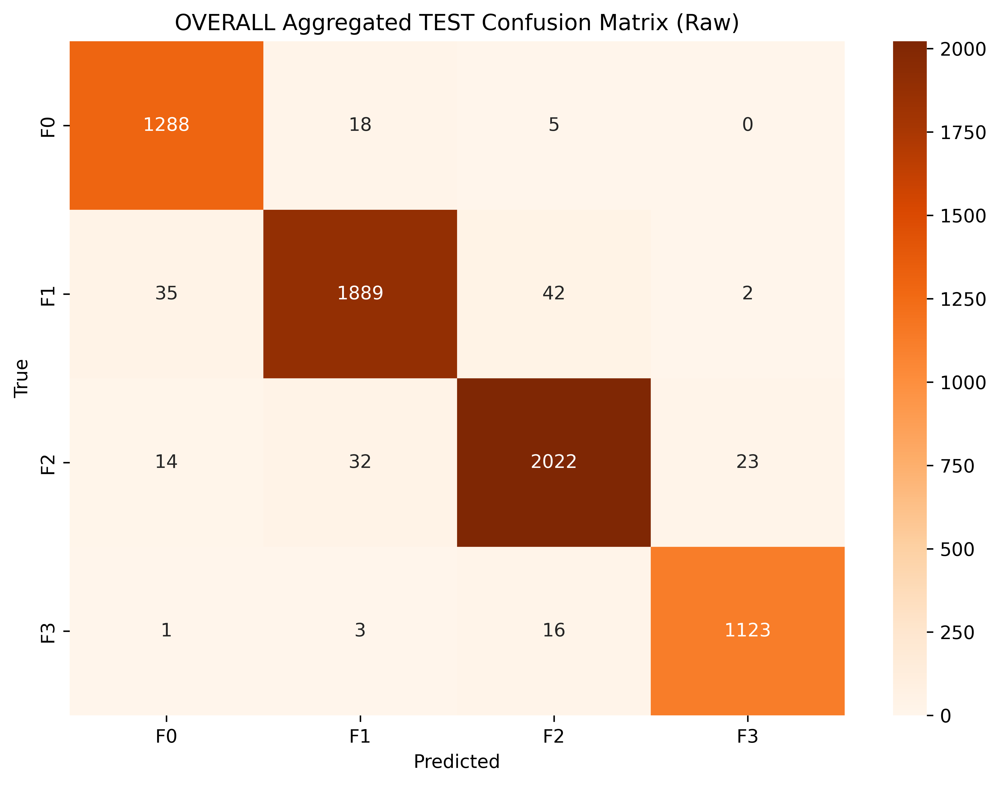

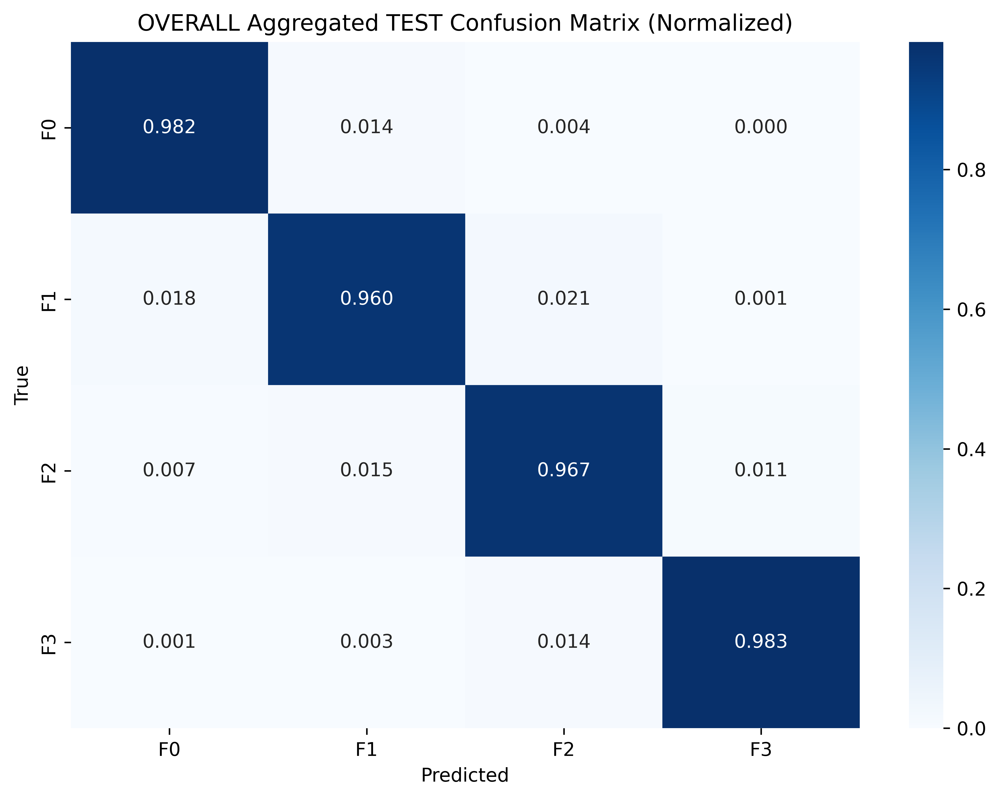


📄 Classification Report (OVERALL aggregated TEST):
              precision    recall  f1-score   support

          F0     0.9626    0.9825    0.9724      1311
          F1     0.9727    0.9599    0.9662      1968
          F2     0.9698    0.9670    0.9684      2091
          F3     0.9782    0.9825    0.9804      1143

    accuracy                         0.9707      6513
   macro avg     0.9708    0.9730    0.9719      6513
weighted avg     0.9707    0.9707    0.9707      6513



In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, cohen_kappa_score

print("\n📌 GAT + DenseNet (MRI): PER-FOLD (fold-model-on-test) + OVERALL (600 DPI)")

# ---- safety ----
if "test_df" not in globals():
    raise NameError("❌ test_df is not defined. Create held-out test_df first.")
if "DenseNetGridGAT" not in globals():
    raise NameError("❌ DenseNetGridGAT not found. Run the model definition cell first.")

# class names
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# test loader
test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

# fold weight files
fold_models = [f"gat_fold{i+1}.pth" for i in range(CFG.N_SPLITS)]

all_true, all_pred = [], []

def load_gat_model(path):
    m = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    m.load_state_dict(torch.load(path, map_location=CFG.DEVICE))
    m.eval()
    return m

for fold, model_path in enumerate(fold_models, start=1):
    if not os.path.exists(model_path):
        print(f"\n⚠️ Skipping Fold-model {fold} (missing): {model_path}")
        continue

    print(f"\n🔹 Fold-model {fold} on TEST set...")
    model = load_gat_model(model_path)

    y_true_fold, y_pred_fold = [], []

    with torch.no_grad():
        for imgs, labels in test_loader:
            imgs = imgs.to(CFG.DEVICE)
            out = model(imgs)
            preds = out.argmax(dim=1).cpu().numpy()

            y_pred_fold.extend(preds)
            y_true_fold.extend(labels.numpy())

    fold_acc = accuracy_score(y_true_fold, y_pred_fold)
    fold_qwk = cohen_kappa_score(y_true_fold, y_pred_fold, weights="quadratic")

    print(f"✅ Fold {fold} TEST Accuracy: {fold_acc:.4f}")
    print(f"✅ Fold {fold} TEST QWK:      {fold_qwk:.4f}")

    # aggregate (NOTE: test repeated across folds → NOT ensemble)
    all_true.extend(y_true_fold)
    all_pred.extend(y_pred_fold)

    # confusion matrix
    cm_raw = confusion_matrix(y_true_fold, y_pred_fold)

    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_raw, annot=True, fmt="d", cmap="Oranges",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"TEST Confusion Matrix (Raw) – Fold-model {fold}")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    cm_norm = cm_raw.astype(float) / (cm_raw.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_norm, annot=True, fmt=".3f", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"TEST Confusion Matrix (Normalized) – Fold-model {fold}")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print(f"\n📄 Classification Report (Fold-model {fold} on TEST):")
    print(classification_report(y_true_fold, y_pred_fold, target_names=class_names, digits=4, zero_division=0))

# ---- aggregated overall (NOT ensemble) ----
all_true = np.array(all_true)
all_pred = np.array(all_pred)

if len(all_true) == 0:
    print("\n❌ No predictions collected. Check weight paths and test_loader.")
else:
    overall_acc = accuracy_score(all_true, all_pred)
    overall_qwk = cohen_kappa_score(all_true, all_pred, weights="quadratic")

    print("\n========================================")
    print("📊 OVERALL (Aggregated) TEST PERFORMANCE")
    print("⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.")
    print(f"✅ Overall Accuracy: {overall_acc:.4f}")
    print(f"✅ Overall QWK:      {overall_qwk:.4f}")
    print("========================================")

    cm_overall = confusion_matrix(all_true, all_pred)

    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_overall, annot=True, fmt="d", cmap="Oranges",
                xticklabels=class_names, yticklabels=class_names)
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Raw)")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    cm_overall_norm = cm_overall.astype(float) / (cm_overall.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_overall_norm, annot=True, fmt=".3f", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Normalized)")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print("\n📄 Classification Report (OVERALL aggregated TEST):")
    print(classification_report(all_true, all_pred, target_names=class_names, digits=4, zero_division=0))



🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + GAT (MRI)...

📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + GAT (MRI)
✅ Test Accuracy: 0.9885
✅ Test QWK:      0.9915

📄 Classification Report:
              precision    recall  f1-score   support

          F0     0.9797    0.9954    0.9875       437
          F1     0.9893    0.9832    0.9862       656
          F2     0.9913    0.9857    0.9885       697
          F3     0.9921    0.9948    0.9934       381

    accuracy                         0.9885      2171
   macro avg     0.9881    0.9898    0.9889      2171
weighted avg     0.9885    0.9885    0.9885      2171



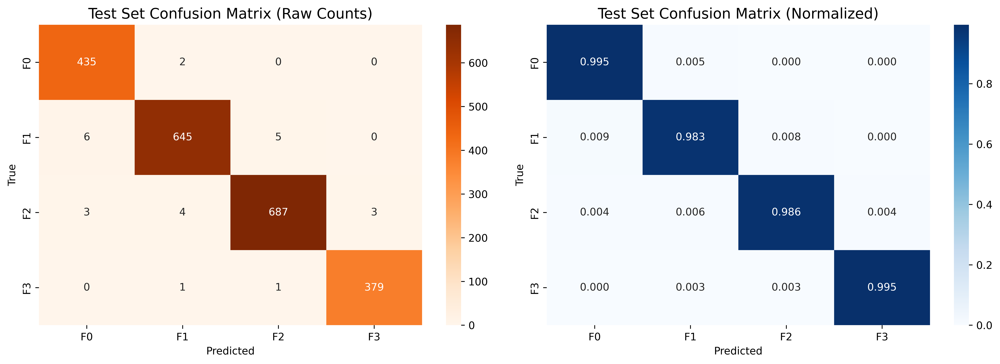


✅ Saved: test_confusion_matrix_ensemble_gat_mri.png
✅ all_probs saved for ROC/AUC cell (GAT).


In [12]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import accuracy_score, cohen_kappa_score, confusion_matrix, classification_report

print("\n🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + GAT (MRI)...")

# safety
if "test_df" not in globals():
    raise NameError("❌ test_df not defined.")
if "DenseNetGridGAT" not in globals():
    raise NameError("❌ DenseNetGridGAT not defined.")

test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

fold_models = [f"gat_fold{i+1}.pth" for i in range(CFG.N_SPLITS)]

# load models
models = []
for p in fold_models:
    if not os.path.exists(p):
        print(f"⚠️ Missing weight file: {p}")
        continue
    m = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    m.load_state_dict(torch.load(p, map_location=CFG.DEVICE))
    m.eval()
    models.append(m)

if len(models) == 0:
    raise FileNotFoundError("❌ No fold models loaded. Check gat_fold*.pth exist.")

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# inference (store probs for ROC)
all_labels, all_preds, all_probs = [], [], []

with torch.no_grad():
    for imgs, labels in test_loader:
        imgs = imgs.to(CFG.DEVICE)

        probs = torch.zeros((imgs.size(0), CFG.NUM_CLASSES), device=CFG.DEVICE)
        for m in models:
            probs += torch.softmax(m(imgs), dim=1)
        probs /= len(models)

        preds = torch.argmax(probs, dim=1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.numpy())
        all_probs.extend(probs.cpu().numpy())

all_labels = np.array(all_labels)
all_preds  = np.array(all_preds)
all_probs  = np.array(all_probs)

acc = accuracy_score(all_labels, all_preds)
qwk = cohen_kappa_score(all_labels, all_preds, weights="quadratic")

print("\n========================================")
print("📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + GAT (MRI)")
print(f"✅ Test Accuracy: {acc:.4f}")
print(f"✅ Test QWK:      {qwk:.4f}")
print("========================================")

print("\n📄 Classification Report:")
print(classification_report(all_labels, all_preds, target_names=class_names, digits=4, zero_division=0))

cm = confusion_matrix(all_labels, all_preds)

fig, ax = plt.subplots(1, 2, figsize=(14, 5), dpi=600)

sns.heatmap(cm, annot=True, fmt="d", cmap="Oranges",
            xticklabels=class_names, yticklabels=class_names, ax=ax[0])
ax[0].set_title("Test Set Confusion Matrix (Raw Counts)", fontsize=14)
ax[0].set_xlabel("Predicted"); ax[0].set_ylabel("True")

cm_norm = cm.astype(float) / (cm.sum(axis=1, keepdims=True) + 1e-8)
sns.heatmap(cm_norm, annot=True, fmt=".3f", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names, ax=ax[1])
ax[1].set_title("Test Set Confusion Matrix (Normalized)", fontsize=14)
ax[1].set_xlabel("Predicted"); ax[1].set_ylabel("True")

plt.tight_layout()
plt.show()

fig.savefig("test_confusion_matrix_ensemble_gat_mri.png", dpi=600, bbox_inches="tight")
print("\n✅ Saved: test_confusion_matrix_ensemble_gat_mri.png")
print("✅ all_probs saved for ROC/AUC cell (GAT).")


🚀 Generating ROC/AUC Curves (GAT MRI)...

📊 ROC/AUC RESULTS (TEST SET) — DenseNet + GAT (MRI)
✅ Micro-average AUC: 0.9996
✅ Macro-average AUC: 0.9996
   - F0 AUC: 0.9998
   - F1 AUC: 0.9995
   - F2 AUC: 0.9988
   - F3 AUC: 0.9999


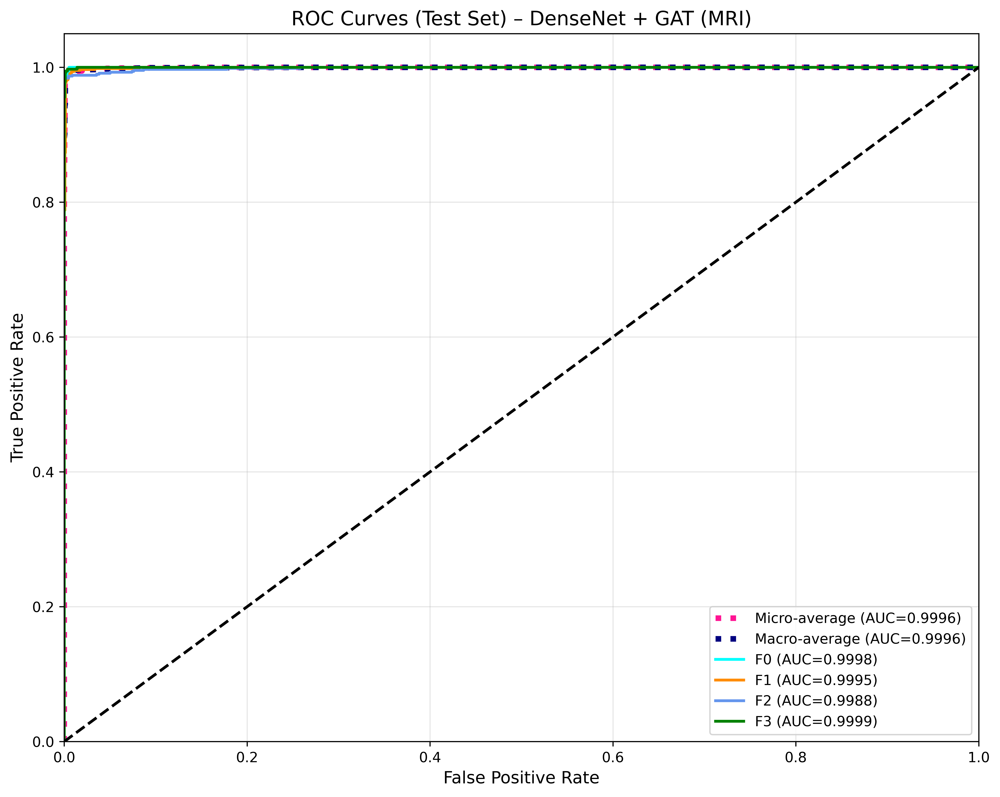

✅ Saved: roc_auc_densenet_gat_mri_test.png


In [13]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from itertools import cycle
import numpy as np
import matplotlib.pyplot as plt

print("🚀 Generating ROC/AUC Curves (GAT MRI)...")

if "all_probs" not in globals() or "all_labels" not in globals():
    raise NameError("❌ Run the ENSEMBLE TEST evaluation cell first to create all_probs and all_labels.")

y_test  = label_binarize(all_labels, classes=range(CFG.NUM_CLASSES))
y_score = all_probs
n_classes = y_test.shape[1]

fpr, tpr, roc_auc = {}, {}, {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# micro
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# macro
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

print("\n========================================")
print("📊 ROC/AUC RESULTS (TEST SET) — DenseNet + GAT (MRI)")
print(f"✅ Micro-average AUC: {roc_auc['micro']:.4f}")
print(f"✅ Macro-average AUC: {roc_auc['macro']:.4f}")
for i in range(n_classes):
    print(f"   - {class_names[i]} AUC: {roc_auc[i]:.4f}")
print("========================================")

fig = plt.figure(figsize=(10, 8), dpi=600)

plt.plot(fpr["micro"], tpr["micro"],
         label=f"Micro-average (AUC={roc_auc['micro']:.4f})",
         color="deeppink", linestyle=":", lw=4)

plt.plot(fpr["macro"], tpr["macro"],
         label=f"Macro-average (AUC={roc_auc['macro']:.4f})",
         color="navy", linestyle=":", lw=4)

colors = cycle(["aqua", "darkorange", "cornflowerblue", "green"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f"{class_names[i]} (AUC={roc_auc[i]:.4f})")

plt.plot([0, 1], [0, 1], "k--", lw=2)
plt.xlim([0.0, 1.0]); plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate", fontsize=12)
plt.ylabel("True Positive Rate", fontsize=12)
plt.title("ROC Curves (Test Set) – DenseNet + GAT (MRI)", fontsize=14)
plt.legend(loc="lower right", fontsize=10)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

fig.savefig("roc_auc_densenet_gat_mri_test.png", dpi=600, bbox_inches="tight")
print("✅ Saved: roc_auc_densenet_gat_mri_test.png")


🧪 Building GAT ensemble for interface test...
✅ Loaded Fold 1: gat_fold1.pth
✅ Loaded Fold 2: gat_fold2.pth
✅ Loaded Fold 3: gat_fold3.pth

🔍 Testing 4 random images per class → total 16 images (4×4)


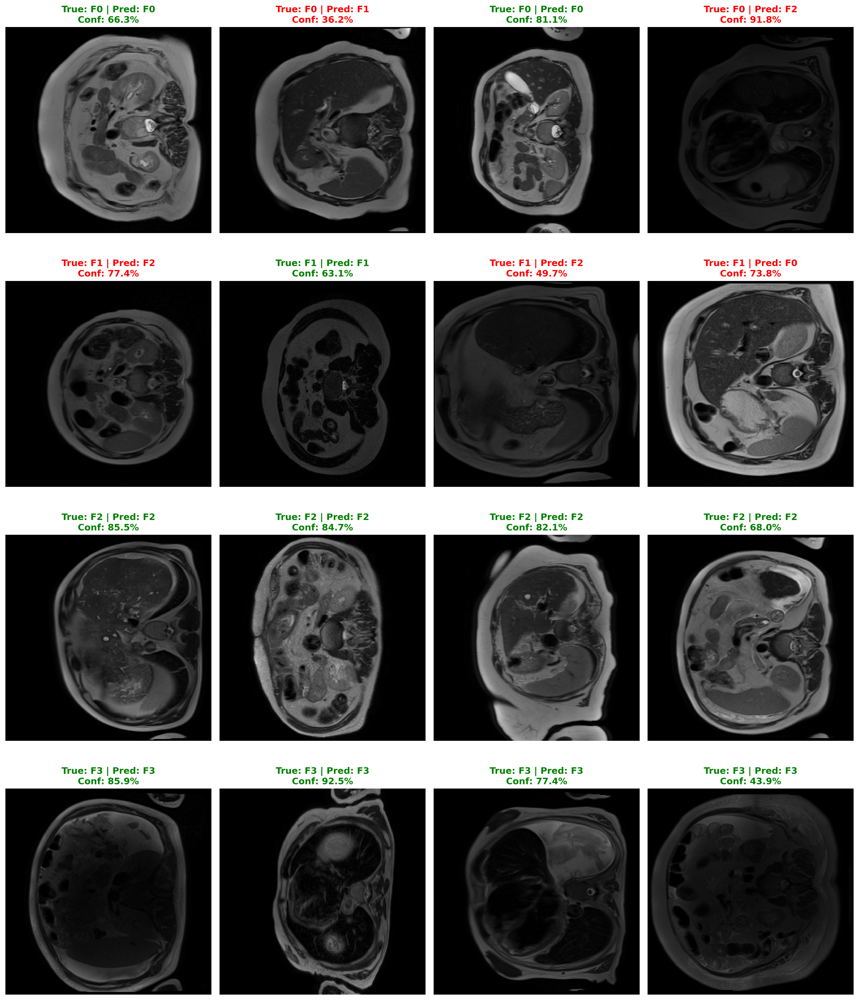

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import os, gc

print("🧪 Building GAT ensemble for interface test...")

class EnsembleGAT(nn.Module):
    def __init__(self):
        super().__init__()
        self.models = nn.ModuleList()
        torch.cuda.empty_cache(); gc.collect()

        for i in range(CFG.N_SPLITS):
            p = f"gat_fold{i+1}.pth"
            if os.path.exists(p):
                m = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES)
                m.load_state_dict(torch.load(p, map_location=CFG.DEVICE))
                m.to(CFG.DEVICE).eval()
                self.models.append(m)
                print(f"✅ Loaded Fold {i+1}: {p}")
            else:
                print(f"⚠️ Missing: {p}")

        if len(self.models) == 0:
            raise FileNotFoundError("❌ No gat_fold*.pth found.")

    def forward(self, x):
        probs = [F.softmax(m(x), dim=1) for m in self.models]
        return torch.mean(torch.stack(probs), dim=0)

ensemble_gat = EnsembleGAT()

def predict_interface_k_per_class(df_data, k=4, dpi=600, seed=42):
    np.random.seed(seed)
    class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

    rows = []
    for c in range(CFG.NUM_CLASSES):
        sub = df_data[df_data["diagnosis"] == c]
        if len(sub) == 0:
            print(f"⚠️ No samples for class {class_names[c]} in this df, skipping.")
            continue
        take = min(k, len(sub))
        sampled = sub.sample(take, random_state=np.random.randint(0, 100000))
        rows.extend(sampled.to_dict("records"))

    if len(rows) == 0:
        print("❌ No samples collected.")
        return

    n = len(rows)
    ncols = k
    nrows = int(np.ceil(n / ncols))

    print(f"\n🔍 Testing {k} random images per class → total {n} images ({nrows}×{ncols})")

    fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 4.8*nrows), dpi=dpi)
    axes = np.array(axes).reshape(nrows, ncols)

    idx = 0
    for r in range(nrows):
        for ccol in range(ncols):
            ax = axes[r, ccol]
            if idx >= n:
                ax.axis("off")
                continue

            row = rows[idx]
            idx += 1

            img = cv2.imread(row["image_path"])
            if img is None:
                ax.axis("off")
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

            t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

            with torch.no_grad():
                p = ensemble_gat(t)[0].cpu().numpy()

            pred = int(np.argmax(p))
            conf = float(p[pred] * 100.0)
            true = int(row["diagnosis"])

            col = "green" if pred == true else "red"
            ax.imshow(img)
            ax.set_title(
                f"True: {class_names[true]} | Pred: {class_names[pred]}\nConf: {conf:.1f}%",
                color=col, fontweight="bold"
            )
            ax.axis("off")

    plt.tight_layout()
    plt.show()

# ✅ Run
predict_interface_k_per_class(test_df, k=4, dpi=300, seed=42)


In [32]:
# ==========================================
# FINAL FIXED XAI VISUALIZATION (DenseNet + GAT MRI)
# ==========================================
import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
import networkx as nx

print("🚀 Generating High-Quality 6-Panel XAI (Fixed Alignment)...")

# -------------------------------
# 1. Configuration & Safety
# -------------------------------
# Ensure we pick the right dataframe (Prefer Test set for evaluation)
def pick_df():
    if "test_df" in globals(): return test_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    raise NameError("❌ DataFrame not found. Please define 'df' or 'test_df'.")

df_use = pick_df()
class_names = list(class_map.keys()) if "class_map" in globals() else ["F0", "F1", "F2", "F3"]

# -------------------------------
# 2. XAI Extraction Engine
# -------------------------------
def extract_gat_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    # Hook for Grad-CAM (Targeting the last dense block output)
    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    # DenseNet121 features are in model.cnn.features
    target_layer = model.cnn.features 
    h = target_layer.register_forward_hook(hook)

    # Forward Pass
    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        # Backprop for Grad-CAM
        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if not fmaps: raise RuntimeError("❌ Feature map hook failed.")

    fmap = fmaps[0].detach()   # [1, 1024, 7, 7] (Typical DenseNet sizes)
    grad = grads[0].detach()   # [1, 1024, 7, 7]
    _, _, Hf, Wf = fmap.shape

    # --- 1. Texture Map (Mean Feature) ---
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = (tex - tex.min()) / (tex.max() - tex.min() + 1e-8)

    # --- 2. Grad-CAM ---
    w = torch.mean(grad, dim=(2,3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    # --- 3. GAT Attention (Node Importance) ---
    # Retrieve attention weights stored in model.last_att during forward()
    if hasattr(model, "last_att") and model.last_att is not None:
        edge_idx, alpha, Bb, Hatt, Watt = model.last_att
        
        # Determine Grid Size from the captured feature map dimensions
        # This ensures alignment with the visual grid
        Grid_H, Grid_W = Hf, Wf 
        
        # Collapse heads if multi-head attention (alpha shape: [Edges, Heads] -> [Edges])
        if alpha.dim() > 1: alpha = alpha.mean(dim=1)
        
        alpha_np = alpha.detach().cpu().numpy()     # [Edges]
        dst_nodes = edge_idx[1].detach().cpu().numpy() # [Edges] - Destination nodes
        
        # Accumulate attention on nodes
        total_nodes = Grid_H * Grid_W
        node_w = np.zeros(total_nodes, dtype=np.float32)
        
        # Sum attention weights pointing to each node
        # We only care about the first image in the batch (batch index 0)
        # The edge indices for batch 0 are in range [0, total_nodes)
        mask = dst_list = dst_nodes < total_nodes
        np.add.at(node_w, dst_nodes[mask], alpha_np[mask])
        
        # Reshape to 2D Grid
        att_grid = node_w.reshape(Grid_H, Grid_W)
    else:
        # Fallback if attention isn't saved
        print("⚠️ Warning: No GAT attention found. Using Grad-CAM as proxy.")
        att_grid = cam 
        Grid_H, Grid_W = Hf, Wf

    # Normalize Attention Map
    att_grid = (att_grid - att_grid.min()) / (att_grid.max() - att_grid.min() + 1e-8)

    return tex, cam, att_grid, pred, conf, Grid_H, Grid_W

# -------------------------------
# 3. Visualization Function (Fixed Overlays & Graph)
# -------------------------------
def plot_gat_6_panel(img, tex, cam, att, true_y, pred_y, conf, Grid_H, Grid_W, dpi=300):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.1, hspace=0.2)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE) # 224x224
    
    # -- Helpers --
    def overlay(mask, colormap=cv2.COLORMAP_JET):
        # Resize mask to image size using CUBIC interpolation for smoothness
        m = cv2.resize(mask, sz, interpolation=cv2.INTER_CUBIC)
        heat = cv2.applyColorMap(np.uint8(255*m), colormap)
        heat = cv2.cvtColor(heat, cv2.COLOR_BGR2RGB)
        return cv2.addWeighted(img, 0.6, heat, 0.4, 0) # Slightly more original image visibility

    tex_ov = overlay(tex, cv2.COLORMAP_VIRIDIS)
    cam_ov = overlay(cam, cv2.COLORMAP_JET)
    att_ov = overlay(att, cv2.COLORMAP_JET)

    font = {'weight': 'bold', 'size': 12}
    name_true = class_names[true_y]
    name_pred = class_names[pred_y]
    
    # === ROW 1 ===
    # 1. Original
    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {name_true}", font)
    
    # 2. CNN Texture
    ax[0,1].imshow(tex_ov)
    ax[0,1].set_title("2. CNN Texture", font)
    
    # 3. Grad-CAM
    ax[0,2].imshow(cam_ov)
    ax[0,2].set_title("3. Grad-CAM", font)

    # === ROW 2 ===
    # 4. Active Nodes (Overlay Dots)
    ax[1,0].imshow(img)
    flat_att = att.flatten()
    
    # Calculate dot positions
    xs = (np.arange(Grid_W) + 0.5) * (sz[1] / Grid_W)
    ys = (np.arange(Grid_H) + 0.5) * (sz[0] / Grid_H)
    X, Y = np.meshgrid(xs, ys)
    
    # Dynamic Threshold: Only show nodes with above-average attention
    # This prevents the "red mark outside" look by focusing on key areas
    threshold = np.mean(flat_att) 
    mask = flat_att > threshold
    
    # Scatter plot
    ax[1,0].scatter(X.flatten()[mask], Y.flatten()[mask], 
                    c=flat_att[mask], s=120, cmap='jet', 
                    edgecolors='white', linewidth=0.8, zorder=10)
    ax[1,0].set_title("4. Active Nodes (GAT)", font)

    # 5. Grid Topology (Clean NetworkX Graph)
    ax[1,1].imshow(img, alpha=0.2) # Very faded background
    
    # Build Graph
    G = nx.grid_2d_graph(Grid_H, Grid_W)
    # Map grid coordinates to image pixels
    pos = {(r, c): ((c+0.5)*(sz[1]/Grid_W), (r+0.5)*(sz[0]/Grid_H)) 
           for r in range(Grid_H) for c in range(Grid_W)}
    
    # Get weights
    node_weights = [att[r,c] for r,c in G.nodes()]
    
    # Draw
    nx.draw_networkx_edges(G, pos, ax=ax[1,1], edge_color='white', alpha=0.4, width=1.0)
    nx.draw_networkx_nodes(G, pos, ax=ax[1,1], 
                           node_color=node_weights, cmap=plt.cm.jet, 
                           node_size=[100 + w * 500 for w in node_weights], # Size scales with attention
                           alpha=0.9, edgecolors='black', linewidths=0.5)
    
    ax[1,1].set_title("5. GAT Grid Topology", font)
    ax[1,1].set_xlim(0, sz[1]); ax[1,1].set_ylim(sz[0], 0)

    # 6. Diagnosis Zone
    ax[1,2].imshow(att_ov)
    col = 'green' if true_y == pred_y else 'red'
    ax[1,2].set_title(f"6. Diagnosis Zone\nPred: {name_pred} ({conf*100:.1f}%)", font, color=col)

    for a in ax.flatten(): a.axis('off')
    plt.tight_layout()
    plt.show()

# -------------------------------
# 4. EXECUTION
# -------------------------------
# A. Load Model Strictly (Use best fold weights)
weights_path = "gat_fold1.pth" 
if not os.path.exists(weights_path):
    # Try alternate location if in a new session
    weights_path = "/kaggle/working/gat_fold1.pth"

if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ CRITICAL: '{weights_path}' not found. Train the model first!")

print(f"✅ Loading model weights: {weights_path}")
model = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

# B. Sanity Check (Test Accuracy on 1 Batch)
print("\n🧪 Running Sanity Check on 1 batch...")
temp_loader = DataLoader(LiverDataset(df_use.sample(16), valid_tfms), batch_size=16)
imgs, lbls = next(iter(temp_loader))
with torch.no_grad():
    outs = model(imgs.to(CFG.DEVICE))
    preds = outs.argmax(1).cpu()
    acc = (preds == lbls).float().mean().item()
print(f"   Batch Accuracy: {acc*100:.1f}% (Should be >25%)")

# C. Run Visualization on Random Samples
print("\n🖼️ Visualizing Random Samples from Test Set...")
for c in range(CFG.NUM_CLASSES):
    # Filter by class
    sub = df_use[df_use.diagnosis == c]
    if len(sub) == 0: continue
    
    # Pick random sample
    row = sub.sample(1).iloc[0]
    
    # Load & Preprocess (Exactly as in training)
    img_raw = cv2.imread(row.image_path)
    if img_raw is None: continue
    # Apply your custom preprocessing pipeline
    img_prep = preprocess_for_model(row.image_path) 
    
    # Resize for visualization/model input
    img_vis = cv2.resize(img_prep, (CFG.IMG_SIZE, CFG.IMG_SIZE))
    
    # Transform for Model (Normalize + Tensor)
    # We re-use valid_tfms but applied on the preprocessed image
    t = valid_tfms(image=img_vis)["image"].unsqueeze(0).to(CFG.DEVICE)
    
    # Generate XAI
    try:
        tex, cam, att, pred, conf, H, W = extract_gat_xai(model, t, true_label=c)
        plot_gat_6_panel(img_vis, tex, cam, att, true_y=c, pred_y=pred, conf=conf, Grid_H=H, Grid_W=W, dpi=600)
    except Exception as e:
        print(f"❌ Error visualising class {c}: {e}")

🚀 Generating High-Quality 6-Panel XAI (Fixed Alignment)...
✅ Loading model weights: gat_fold1.pth

🧪 Running Sanity Check on 1 batch...
   Batch Accuracy: 100.0% (Should be >25%)

🖼️ Visualizing Random Samples from Test Set...


🔬 Generating Polished GAT XAI Report...


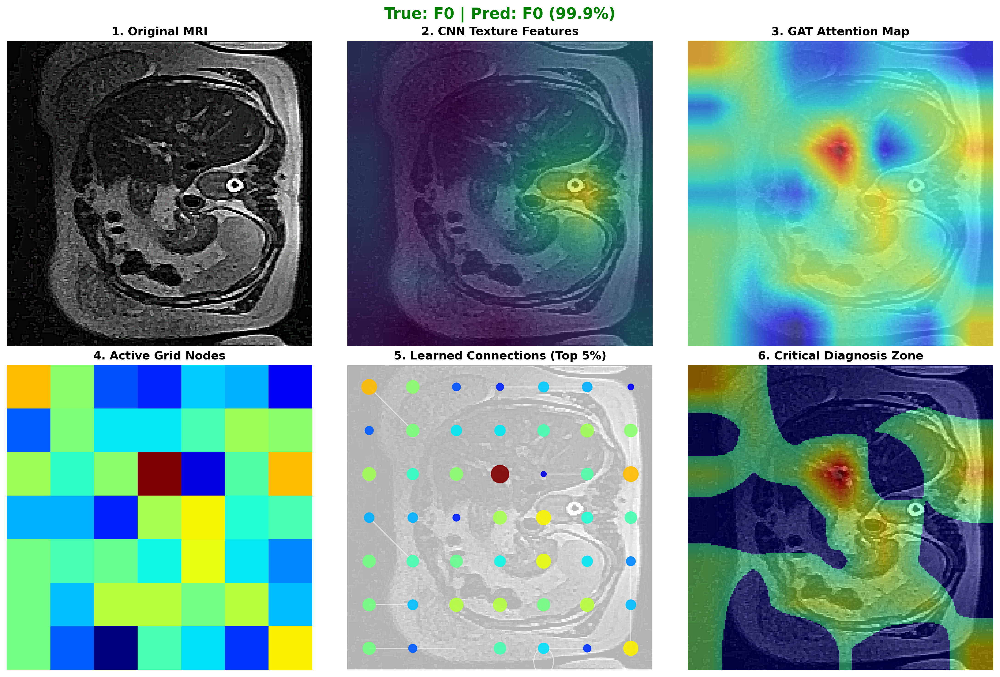

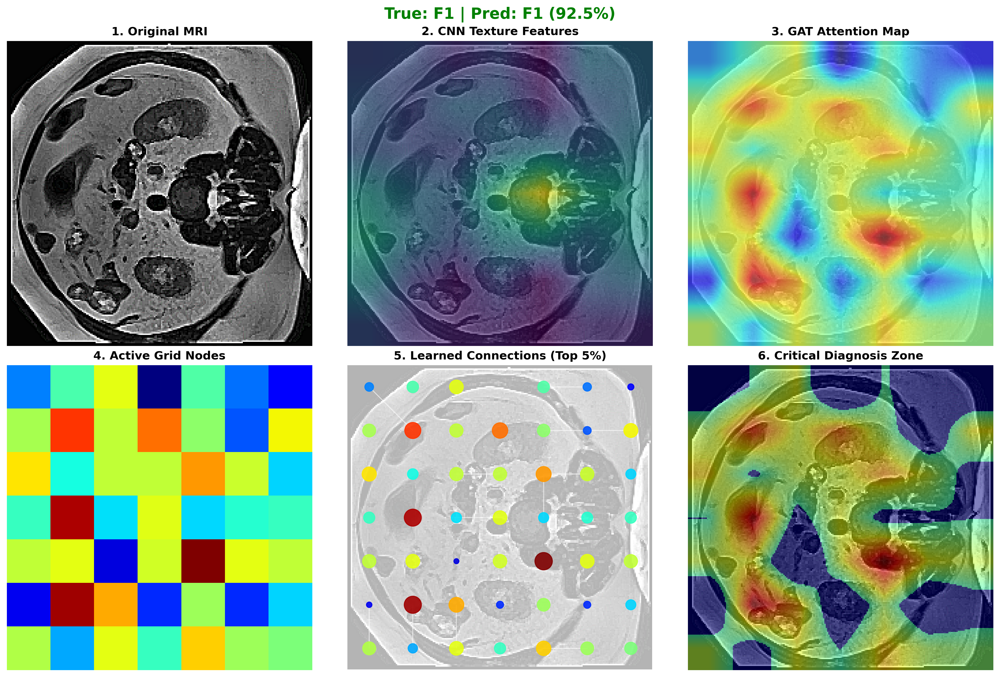

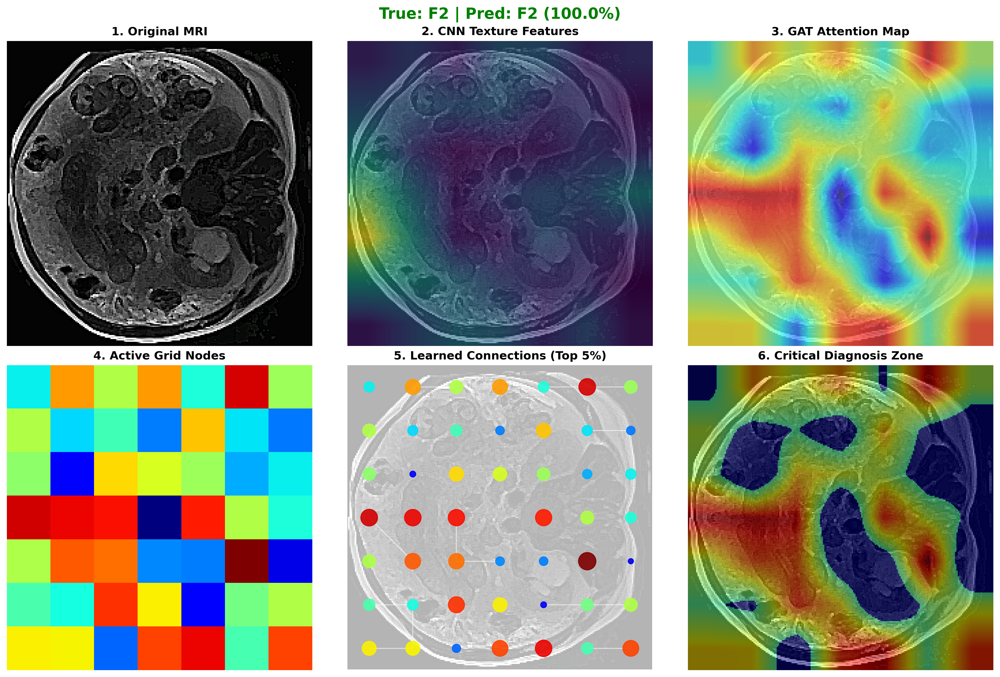

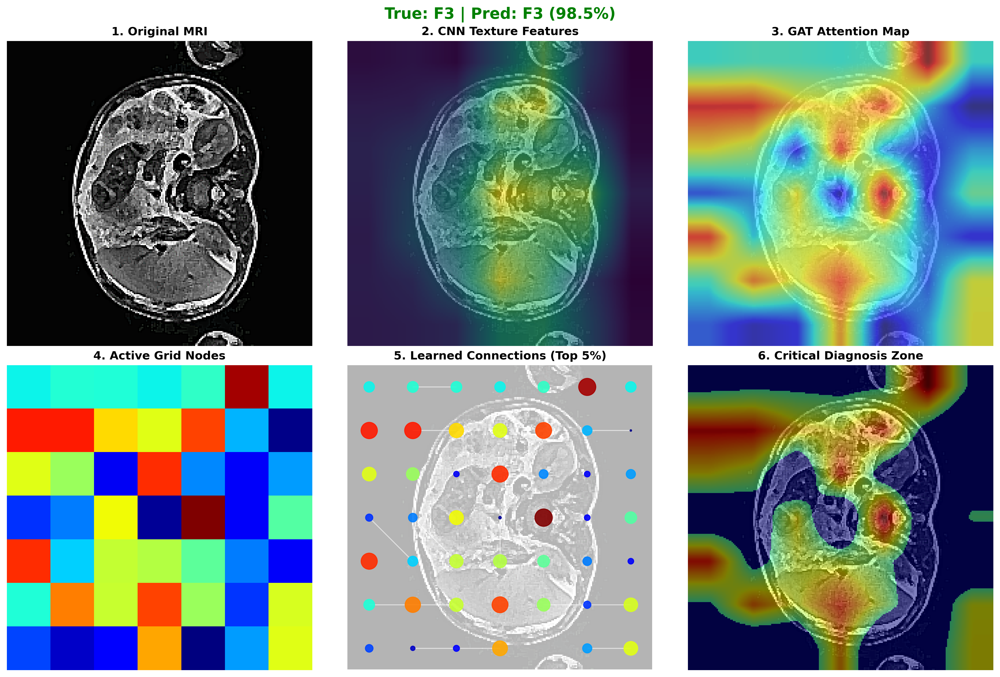

In [34]:
# --- CELL 16: FINAL POLISHED XAI FOR GAT (PAPER READY) ---
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import cv2
import torch
import os

# Ultra-High Res for Paper
plt.rcParams['figure.dpi'] = 300 

def visualize_gat_super_xai(model, img_path, true_label_idx):
    model.eval()
    
    # 1. Prepare Image
    img = preprocess_for_model(img_path)
    disp = cv2.resize(img, (224, 224))
    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)
    
    # 2. Get Features & Attention
    with torch.no_grad():
        logits = model(t)
        probs = torch.softmax(logits, dim=1)[0]
        pred_idx = torch.argmax(probs).item()
        
        # Extract Hooks
        cnn_map = model.cnn.forward_features(t).norm(dim=1)[0].cpu().numpy()
        
        # Get GAT Internals
        if not hasattr(model, 'last_att'):
            print("❌ No attention weights found. Run forward pass first."); return
        edge_idx, alpha, B, H, W = model.last_att
        
        # Process Attention
        alpha = alpha.mean(dim=1).cpu().numpy()
        edge_idx = edge_idx.cpu().numpy()
        num_nodes = H * W
        mask = (edge_idx[0] < num_nodes) & (edge_idx[1] < num_nodes)
        edges = edge_idx[:, mask]
        weights = alpha[mask]
        
        # Map to Nodes
        node_imp = np.zeros(num_nodes)
        for i, target in enumerate(edges[1]): node_imp[target] += weights[i]
        graph_map = node_imp.reshape(H, W)

    # 3. Process Maps
    norm = lambda x: (x - x.min()) / (x.max() - x.min() + 1e-8)
    cnn_hm = cv2.resize(norm(cnn_map), (224, 224))
    
    # Smooth the Graph Heatmap for better visuals
    raw_graph_hm = cv2.resize(norm(graph_map), (224, 224))
    graph_hm = cv2.GaussianBlur(raw_graph_hm, (5, 5), 0) # Smooth edges
    
    # 4. Build Graph Topology
    G = nx.Graph()
    # Use raw node importance for sizing
    nm = norm(node_imp)
    
    for r in range(H):
        for c in range(W):
            nid = r*W + c
            # Center on image block
            px = (c * (224/W)) + (224/W)/2
            py = (r * (224/H)) + (224/H)/2
            G.add_node(nid, pos=(px, py), weight=nm[nid])
            
    # Add Only Top 5% Strongest Edges (Cleaner Look)
    thresh = np.percentile(weights, 95) 
    for i, w in enumerate(weights):
        if w > thresh:
            G.add_edge(edges[0,i], edges[1,i], weight=w)

    # 5. Plotting (2 Rows x 3 Cols for Space)
    fig, ax = plt.subplots(2, 3, figsize=(15, 10))
    
    names = {v:k for k,v in class_map.items()}
    col = 'green' if pred_idx == true_label_idx else 'red'
    conf = probs[pred_idx]*100
    
    fig.suptitle(f"True: {names[true_label_idx]} | Pred: {names[pred_idx]} ({conf:.1f}%)", 
                 fontsize=16, weight='bold', color=col, y=0.98)
    
    # --- ROW 1: Features ---
    # 1. Original
    ax[0,0].imshow(disp); ax[0,0].set_title("1. Original MRI", fontsize=12, fontweight='bold')
    
    # 2. CNN Features
    ax[0,1].imshow(disp, alpha=1); ax[0,1].imshow(cnn_hm, cmap='viridis', alpha=0.6)
    ax[0,1].set_title("2. CNN Texture Features", fontsize=12, fontweight='bold')
    
    # 3. GAT Activation
    ax[0,2].imshow(disp, alpha=0.5); ax[0,2].imshow(graph_hm, cmap='jet', alpha=0.6)
    ax[0,2].set_title("3. GAT Attention Map", fontsize=12, fontweight='bold')
    
    # --- ROW 2: Graph Logic ---
    # 4. Active Nodes
    ax[1,0].imshow(graph_map, cmap='jet', interpolation='nearest')
    ax[1,0].set_title("4. Active Grid Nodes", fontsize=12, fontweight='bold')
    
    # 5. Graph Topology (High Contrast)
    ax[1,1].imshow(disp, alpha=0.3)
    pos = nx.get_node_attributes(G, 'pos')
    # Draw Edges (Thinner, cleaner)
    nx.draw_networkx_edges(G, pos, ax=ax[1,1], edge_color='white', alpha=0.6, width=1.0)
    # Draw Nodes (Big & Bright)
    ws = [G.nodes[n]['weight'] for n in G.nodes]
    nx.draw_networkx_nodes(G, pos, ax=ax[1,1], 
                           node_size=[w*350 for w in ws], 
                           node_color=ws, cmap=plt.cm.jet, alpha=0.9)
    ax[1,1].set_title("5. Learned Connections (Top 5%)", fontsize=12, fontweight='bold')
    ax[1,1].set_ylim(224, 0); ax[1,1].set_xlim(0, 224)
    
    # 6. Final Diagnosis
    clean = graph_hm.copy(); clean[clean<0.4]=0
    ax[1,2].imshow(disp); ax[1,2].imshow(clean, cmap='jet', alpha=0.5)
    ax[1,2].set_title("6. Critical Diagnosis Zone", fontsize=12, fontweight='bold')
    
    for row in ax:
        for a in row: a.axis('off')
    plt.tight_layout()
    plt.show()

# Run XAI Loop
print("🔬 Generating Polished GAT XAI Report...")
model = DenseNetGridGAT(CFG.NUM_CLASSES).to(CFG.DEVICE)
if os.path.exists("gat_fold1.pth"): 
    model.load_state_dict(torch.load("gat_fold1.pth", map_location=CFG.DEVICE))

# Ensure classes are defined
classes = ['F0', 'F1', 'F2', 'F3']

for i, cls in enumerate(classes):
    try:
        row = df[df.diagnosis==i].sample(1).iloc[0]
        visualize_gat_super_xai(model, row.image_path, i)
    except: pass

🚀 Generating 6-Panel XAI for DenseNet121 + GAT (MRI) — GRID LINES VERSION...

--- True: F0 | Pred: F0 (99.5%) ---


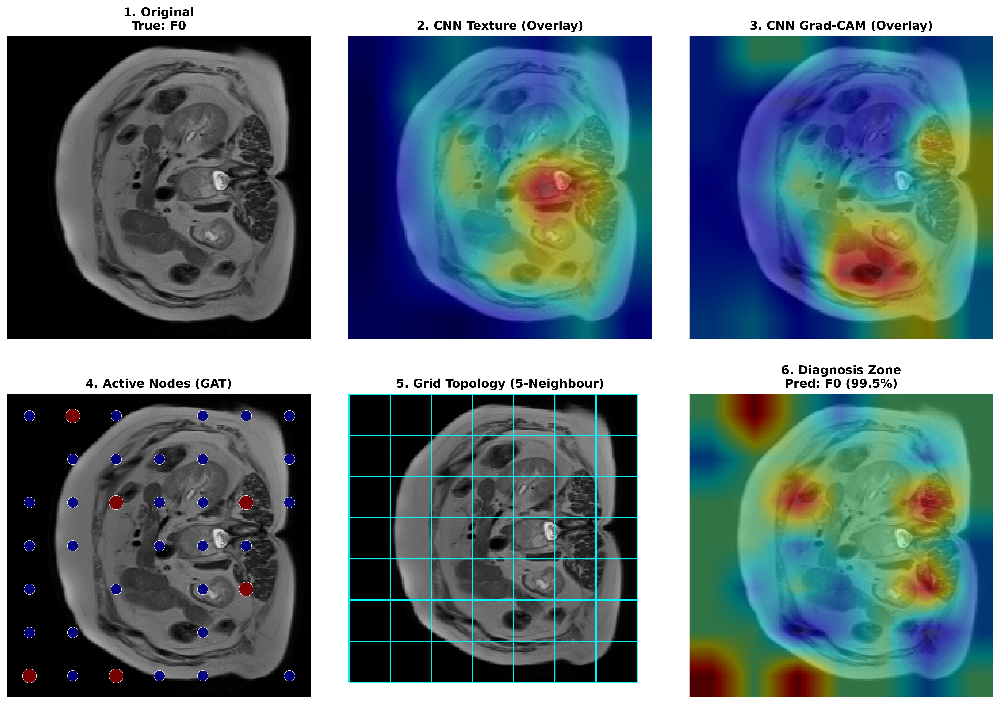


--- True: F1 | Pred: F2 (95.5%) ---


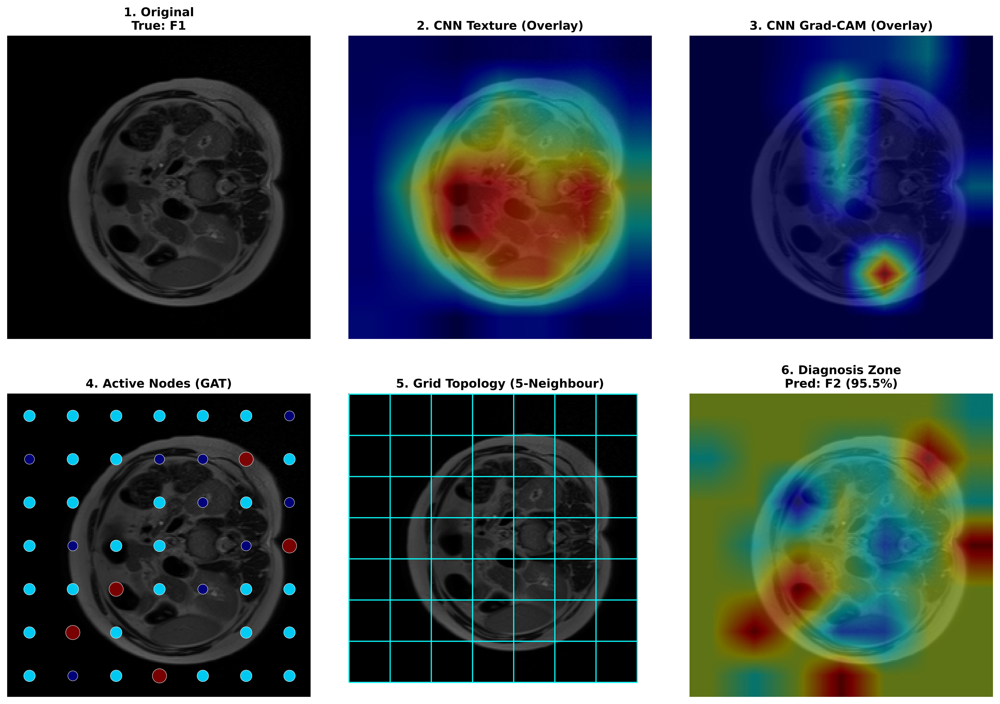


--- True: F2 | Pred: F2 (91.7%) ---


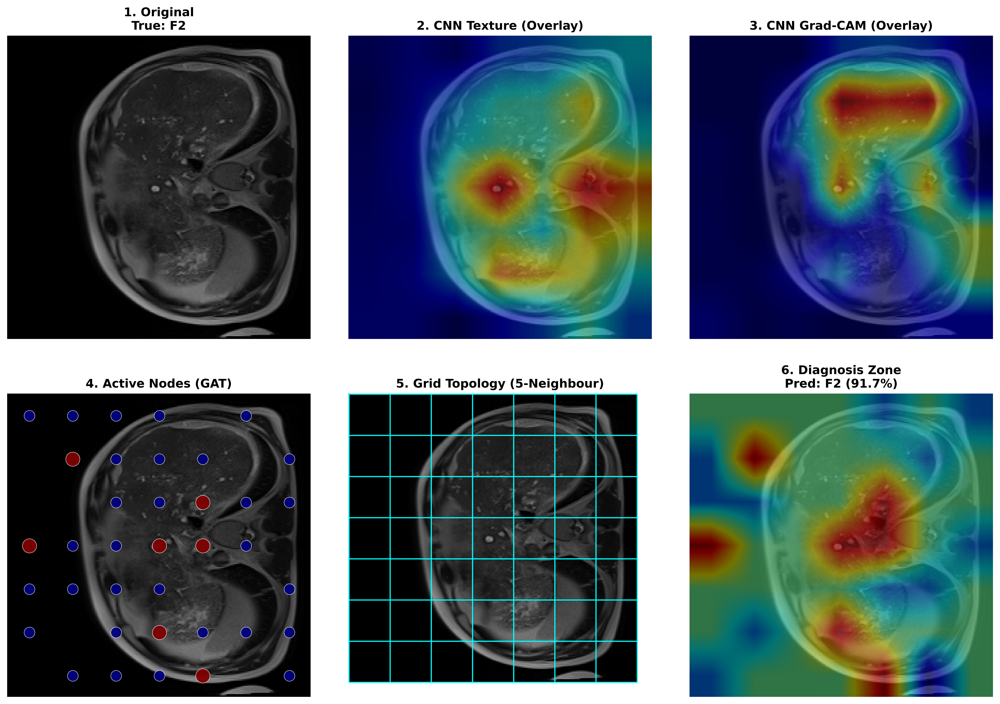


--- True: F3 | Pred: F3 (72.9%) ---


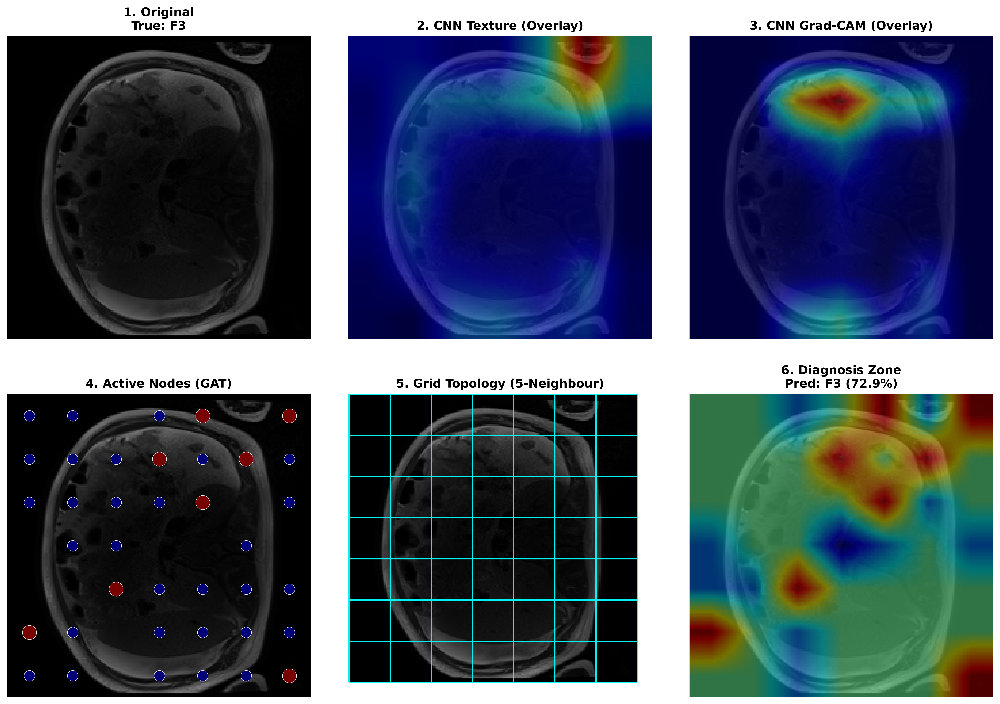

In [15]:
import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F

print("🚀 Generating 6-Panel XAI for DenseNet121 + GAT (MRI) — GRID LINES VERSION...")

# -------------------------------
# Pick dataframe safely
# -------------------------------
def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / trainval_df / train_val_df / df")

df_use = pick_df_for_xai()
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# -------------------------------
# Helpers
# -------------------------------
def norm01(x):
    x = np.asarray(x, dtype=np.float32)
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)  # BGR
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def grid_node_positions(H, W, img_size=224):
    xs = (np.arange(W) + 0.5) * (img_size / W)
    ys = (np.arange(H) + 0.5) * (img_size / H)
    X, Y = np.meshgrid(xs, ys)            # [H,W]
    return X.flatten(), Y.flatten()       # [H*W], [H*W]

# -------------------------------
# Extract XAI for GAT:
# - hook DenseNet features for texture + grad-cam
# - get GAT attention map from model.last_att
# -------------------------------
def extract_gat_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "cnn"):
        raise AttributeError("❌ model.cnn not found (DenseNet backbone missing).")

    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if len(fmaps) == 0 or len(grads) == 0:
        raise RuntimeError("❌ Hook did not capture fmap/grad. Check hook_target.")

    fmap = fmaps[0].detach()   # [B,C,H,W]
    grad = grads[0].detach()   # [B,C,H,W]
    B, C, Hf, Wf = fmap.shape

    # 1) Texture
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = norm01(tex)

    # 2) Grad-CAM
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = norm01(cam)

    # 3) GAT attention → node weights (from last_att saved in forward)
    if not hasattr(model, "last_att") or model.last_att is None:
        raise RuntimeError("❌ model.last_att missing. Ensure your forward() sets self.last_att.")

    edge_idx, alpha, Bb, Hatt, Watt = model.last_att

    # alpha: [E, heads] or [E,1] -> [E]
    if alpha.dim() == 2:
        alpha_e = alpha.mean(dim=1).detach().cpu().numpy()
    else:
        alpha_e = alpha.detach().cpu().numpy()

    edge_idx = edge_idx.detach().cpu().numpy()  # [2,E]
    dst = edge_idx[1]

    N = Hatt * Watt
    node_w = np.zeros((Bb * N,), dtype=np.float32)
    for e in range(len(alpha_e)):
        node_w[dst[e]] += alpha_e[e]

    # take first image in batch
    att = node_w[:N].reshape(Hatt, Watt)
    att = norm01(att)

    return tex, cam, att, pred, conf, Hf, Wf, Hatt, Watt

# -------------------------------
# Plot 6-panel (Panel 5 = GRID LINES)
# -------------------------------
def plot_gat_6_panel_gridlines(img, tex, cam, att, true_y, pred_y, conf, Hatt, Watt, dpi=600):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs = cv2.resize(tex, sz)
    cam_rs = cv2.resize(cam, sz)
    att_rs = cv2.resize(att, sz)

    tex_overlay = overlay_heatmap_on_image(img, tex_rs, alpha=0.45)
    cam_overlay = overlay_heatmap_on_image(img, cam_rs, alpha=0.45)
    att_overlay = overlay_heatmap_on_image(img, att_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    # 1) Original
    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    # 2) CNN Texture
    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    # 3) CNN Grad-CAM
    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    # 4) Active Nodes (GAT attention)
    ax[1,0].imshow(img)
    X, Y = grid_node_positions(Hatt, Watt, img_size=CFG.IMG_SIZE)
    flat = att.flatten()
    mask = flat > 0.25
    sizes = 30 + flat[mask] * 180
    ax[1,0].scatter(
        X[mask], Y[mask],
        c=flat[mask], s=sizes, cmap="jet",
        alpha=0.95, edgecolors="white", linewidths=0.4, zorder=10
    )
    ax[1,0].set_title("4. Active Nodes (GAT)", font)

    # 5) GRID LINES ONLY (like SGN grid-lines version)
    ax[1,1].imshow(img, alpha=1.0)

    step_x = CFG.IMG_SIZE / Watt
    step_y = CFG.IMG_SIZE / Hatt

    xs = np.arange(0, CFG.IMG_SIZE + 1e-6, step_x)
    ys = np.arange(0, CFG.IMG_SIZE + 1e-6, step_y)

    ax[1,1].vlines(xs, 0, CFG.IMG_SIZE, colors="cyan", linewidth=1.2, alpha=0.95, zorder=10)
    ax[1,1].hlines(ys, 0, CFG.IMG_SIZE, colors="cyan", linewidth=1.2, alpha=0.95, zorder=10)

    ax[1,1].set_title("5. Grid Topology (5-Neighbour)", font)

    # 6) Diagnosis Zone (attention overlay)
    ax[1,2].imshow(att_overlay)
    ax[1,2].set_title(f"6. Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")
    plt.show()

# -------------------------------
# Load model (fold1) for XAI
# -------------------------------
weights_path = "gat_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

# -------------------------------
# Run random examples (1 per class)
# -------------------------------
np.random.seed(42)
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    tex, cam, att, pred, conf, Hf, Wf, Hatt, Watt = extract_gat_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
    plot_gat_6_panel_gridlines(
        img, tex, cam, att,
        true_y=c, pred_y=pred, conf=conf,
        Hatt=Hatt, Watt=Watt, dpi=600
    )


🚀 Generating 6-Panel XAI for DenseNet121 + GAT (MRI)...

--- True: F0 | Pred: F0 (99.5%) ---


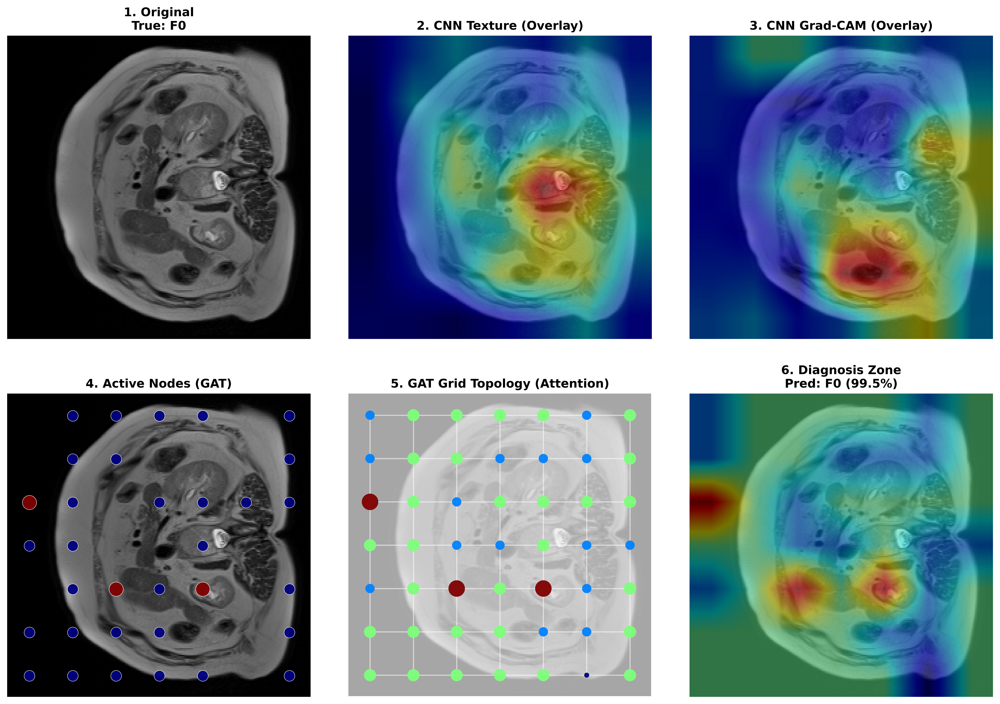


--- True: F1 | Pred: F2 (95.5%) ---


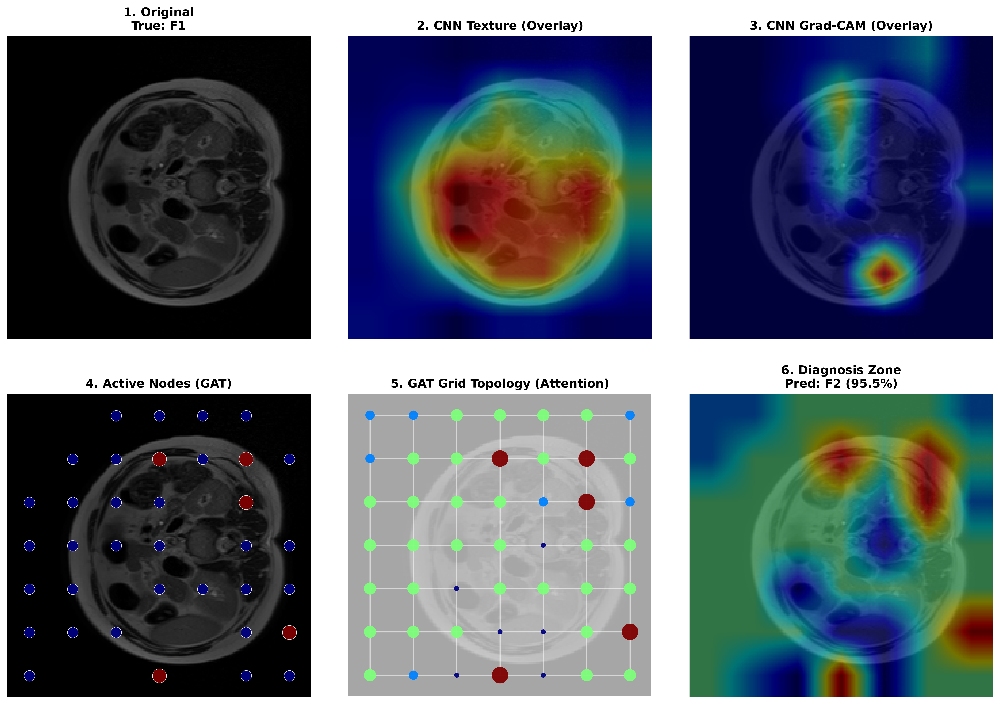


--- True: F2 | Pred: F2 (91.7%) ---


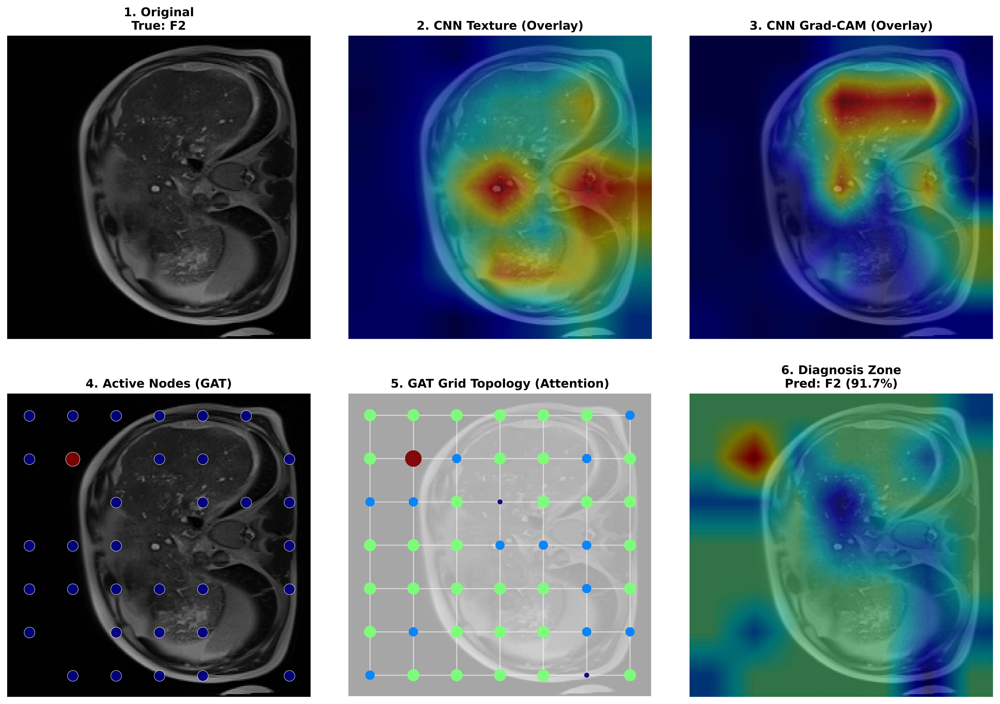


--- True: F3 | Pred: F3 (72.9%) ---


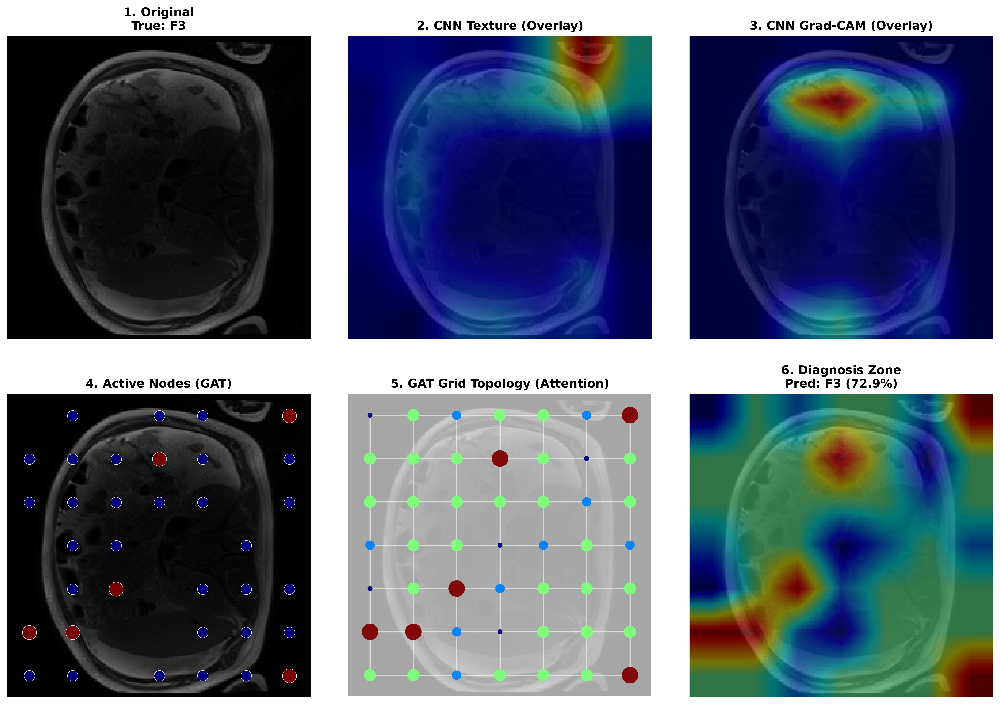

In [16]:
import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
import networkx as nx

print("🚀 Generating 6-Panel XAI for DenseNet121 + GAT (MRI)...")

# -------------------------------
# Pick dataframe safely
# -------------------------------
def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "trainval_df" in globals(): return trainval_df
    if "train_val_df" in globals(): return train_val_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / trainval_df / train_val_df / df")

df_use = pick_df_for_xai()
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# -------------------------------
# Helpers
# -------------------------------
def norm01(x):
    x = np.asarray(x, dtype=np.float32)
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)  # BGR
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def build_grid_graph(H, W, node_weights_01, img_size=224):
    G = nx.Graph()
    for r in range(H):
        for c in range(W):
            nid = r * W + c
            px = (c + 0.5) * (img_size / W)
            py = (r + 0.5) * (img_size / H)
            G.add_node(nid, pos=(px, py), weight=float(node_weights_01[r, c]))
            if c + 1 < W: G.add_edge(nid, nid + 1)
            if r + 1 < H: G.add_edge(nid, nid + W)
    return G

# -------------------------------
# XAI extraction (GAT):
# - Grad-CAM on CNN feature map (hook timm DenseNet -> model.cnn.features)
# - GAT attention map from model.last_att (saved in forward)
# -------------------------------
def extract_gat_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    # hook DenseNet feature map
    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    fmap = fmaps[0].detach()   # [B,C,H,W]
    grad = grads[0].detach()   # [B,C,H,W]
    B, C, Hf, Wf = fmap.shape

    # texture
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = norm01(tex)

    # grad-cam
    w = torch.mean(grad, dim=(2,3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = norm01(cam)

    # GAT attention → node weights
    # model.last_att = (edge_idx2, alpha2, B, H, W) in your forward
    if not hasattr(model, "last_att") or model.last_att is None:
        raise RuntimeError("❌ model.last_att not found. Ensure forward() stores self.last_att.")

    edge_idx, alpha, Bb, Hatt, Watt = model.last_att
    # alpha: [E, heads] or [E,1] -> convert to [E]
    if alpha.dim() == 2:
        alpha_e = alpha.mean(dim=1).detach().cpu().numpy()
    else:
        alpha_e = alpha.detach().cpu().numpy()

    edge_idx = edge_idx.detach().cpu().numpy()  # [2,E]

    # accumulate attention per destination node
    N = Hatt * Watt
    node_w = np.zeros((Bb * N,), dtype=np.float32)
    dst = edge_idx[1]  # destination nodes
    for e in range(len(alpha_e)):
        node_w[dst[e]] += alpha_e[e]

    # only first image in batch
    node_w0 = node_w[:N].reshape(Hatt, Watt)
    node_w0 = norm01(node_w0)

    return tex, cam, node_w0, pred, conf, Hf, Wf, Hatt, Watt

# -------------------------------
# Plot 6-panel
# -------------------------------
def plot_gat_6_panel(img, tex, cam, att, true_y, pred_y, conf, Hatt, Watt, dpi=600):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs = cv2.resize(tex, sz)
    cam_rs = cv2.resize(cam, sz)
    att_rs = cv2.resize(att, sz)

    tex_overlay = overlay_heatmap_on_image(img, tex_rs, alpha=0.45)
    cam_overlay = overlay_heatmap_on_image(img, cam_rs, alpha=0.45)
    att_overlay = overlay_heatmap_on_image(img, att_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    # 4) Active nodes (high attention)
    ax[1,0].imshow(img)
    flat = att.flatten()
    # node centers
    xs = (np.arange(Watt) + 0.5) * (CFG.IMG_SIZE / Watt)
    ys = (np.arange(Hatt) + 0.5) * (CFG.IMG_SIZE / Hatt)
    X, Y = np.meshgrid(xs, ys)
    Xf, Yf = X.flatten(), Y.flatten()

    mask = flat > 0.25
    sizes = 30 + flat[mask] * 180
    ax[1,0].scatter(Xf[mask], Yf[mask], c=flat[mask], s=sizes, cmap="jet",
                    alpha=0.95, edgecolors="white", linewidths=0.4, zorder=10)
    ax[1,0].set_title("4. Active Nodes (GAT)", font)

    # 5) Grid topology + node colors like your picture
    ax[1,1].imshow(img, alpha=0.35)
    G = build_grid_graph(Hatt, Watt, att, img_size=CFG.IMG_SIZE)
    pos = nx.get_node_attributes(G, "pos")
    ws  = np.array([G.nodes[n]["weight"] for n in G.nodes], dtype=np.float32)

    nx.draw_networkx_edges(G, pos, ax=ax[1,1], edge_color="white", alpha=0.55, width=1.1)
    node_sizes = 25 + ws * 260
    nx.draw_networkx_nodes(G, pos, ax=ax[1,1],
                           node_size=node_sizes,
                           node_color=ws, cmap=plt.cm.jet,
                           alpha=0.95, linewidths=0.0)

    ax[1,1].set_title("5. GAT Grid Topology (Attention)", fontsize=12, fontweight="bold")
    ax[1,1].set_ylim(CFG.IMG_SIZE, 0)
    ax[1,1].set_xlim(0, CFG.IMG_SIZE)

    # 6) Diagnosis zone overlay (attention)
    ax[1,2].imshow(att_overlay)
    ax[1,2].set_title(f"6. Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")
    plt.show()

# -------------------------------
# Load model (fold1) for XAI
# -------------------------------
weights_path = "gat_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

# -------------------------------
# Run random examples (1 per class)
# -------------------------------
np.random.seed(42)
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    tex, cam, att, pred, conf, Hf, Wf, Hatt, Watt = extract_gat_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
    plot_gat_6_panel(img, tex, cam, att, true_y=c, pred_y=pred, conf=conf, Hatt=Hatt, Watt=Watt, dpi=600)


✅ FINAL FIXED GAT XAI (MRI) — Foreground-aligned, no retrain, no model change

--- True: F0 | Pred: F0 (99.2%) ---


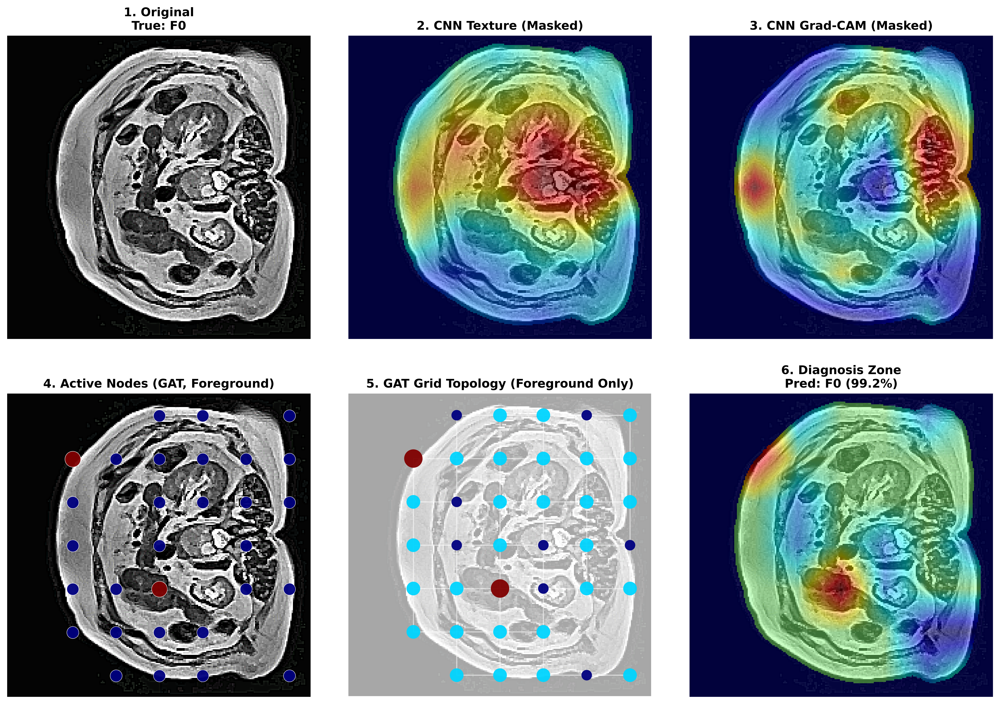


--- True: F1 | Pred: F1 (98.8%) ---


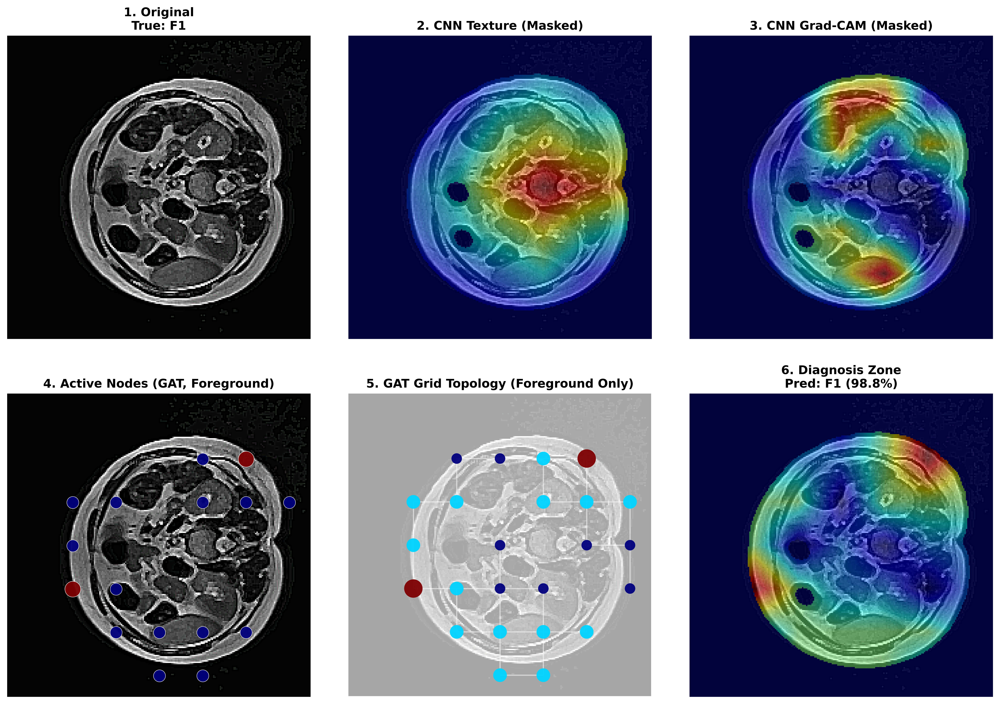


--- True: F2 | Pred: F2 (99.4%) ---


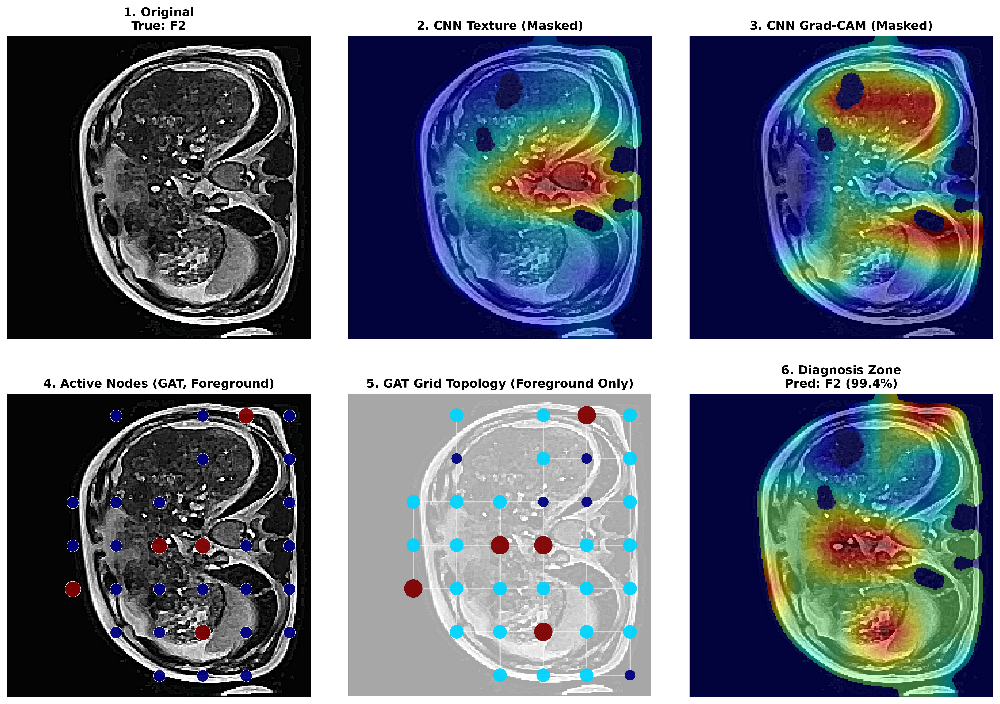


--- True: F3 | Pred: F3 (77.0%) ---


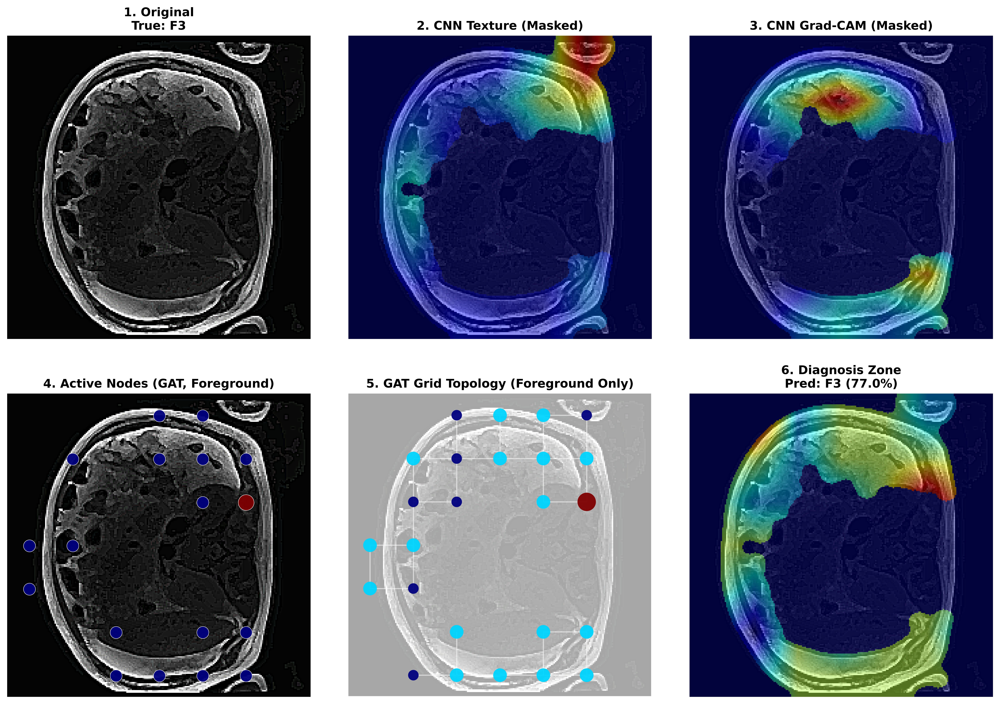

In [27]:
import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
import networkx as nx

print("✅ FINAL FIXED GAT XAI (MRI) — Foreground-aligned, no retrain, no model change")

# --------------------------------------------------
# Select dataframe safely
# --------------------------------------------------
def pick_df_for_xai():
    if "test_df" in globals():  return test_df
    if "train_df" in globals(): return train_df
    if "df" in globals():       return df
    raise NameError("❌ No dataframe found. Define one of: test_df / train_df / df")

df_use = pick_df_for_xai()

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# --------------------------------------------------
# Helpers
# --------------------------------------------------
def norm01(x):
    x = np.asarray(x, dtype=np.float32)
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.45, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def grid_node_positions(H, W, img_size=224):
    xs = (np.arange(W) + 0.5) * (img_size / W)
    ys = (np.arange(H) + 0.5) * (img_size / H)
    X, Y = np.meshgrid(xs, ys)
    return X.flatten(), Y.flatten()

def build_grid_graph(H, W, node_weights_01, fg_mask_hw=None, img_size=224):
    """
    Grid graph with optional foreground filtering:
    - fg_mask_hw: boolean mask [H,W] ; if provided, nodes/edges outside are removed
    """
    G = nx.Graph()
    keep = np.ones((H, W), dtype=bool) if fg_mask_hw is None else fg_mask_hw.astype(bool)

    for r in range(H):
        for c in range(W):
            if not keep[r, c]:
                continue
            nid = r * W + c
            px = (c + 0.5) * (img_size / W)
            py = (r + 0.5) * (img_size / H)
            G.add_node(nid, pos=(px, py), weight=float(node_weights_01[r, c]))

            # right and down edges only (clean)
            if c + 1 < W and keep[r, c+1]:
                G.add_edge(nid, nid + 1)
            if r + 1 < H and keep[r+1, c]:
                G.add_edge(nid, nid + W)
    return G

def make_foreground_mask(img_rgb):
    """
    Foreground mask for MRI body:
    - grayscale
    - Otsu threshold
    - morphology close/open
    - keep largest connected region
    Returns: mask_224 (bool, H=W=CFG.IMG_SIZE)
    """
    g = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

    # Otsu threshold (MRI background is near black)
    _, th = cv2.threshold(g, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # sometimes Otsu can invert (rare). Fix if needed
    if th.mean() < 10:
        th = cv2.bitwise_not(th)

    # morphology to fill holes / remove noise
    k = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9, 9))
    th = cv2.morphologyEx(th, cv2.MORPH_CLOSE, k, iterations=2)
    th = cv2.morphologyEx(th, cv2.MORPH_OPEN,  k, iterations=1)

    # keep largest component
    num, labels, stats, _ = cv2.connectedComponentsWithStats(th, connectivity=8)
    if num <= 1:
        return (th > 0)

    largest = 1 + np.argmax(stats[1:, cv2.CC_STAT_AREA])
    mask = (labels == largest)

    # gentle dilation to include boundary pixels
    k2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
    mask = cv2.dilate(mask.astype(np.uint8)*255, k2, iterations=1) > 0
    return mask

def downsample_mask(mask_224, H, W):
    """
    Downsample boolean mask from 224x224 to HxW (feature grid).
    Use area interpolation then threshold.
    """
    m = mask_224.astype(np.uint8) * 255
    m_small = cv2.resize(m, (W, H), interpolation=cv2.INTER_AREA)
    return (m_small > 40)  # threshold tuned for stability

# --------------------------------------------------
# Extract GAT XAI (no model changes)
# - CNN texture + Grad-CAM from DenseNet feature hook
# - GAT node importance from model.last_att attention weights
# --------------------------------------------------
def extract_gat_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)             # forward sets last_att
        probs  = torch.softmax(logits, dim=1)

        pred = logits.argmax(1).item()
        conf = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if len(fmaps) == 0 or len(grads) == 0:
        raise RuntimeError("❌ CNN hook failed (no feature maps / grads captured).")

    fmap = fmaps[0].detach()   # [B,C,Hf,Wf]
    grad = grads[0].detach()
    B, C, Hf, Wf = fmap.shape

    # CNN texture
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = norm01(tex)

    # Grad-CAM
    w = torch.mean(grad, dim=(2,3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = norm01(cam)

    # ---- GAT attention -> NODE importance (first sample only) ----
    if not hasattr(model, "last_att") or model.last_att is None:
        raise RuntimeError("❌ model.last_att not found. Ensure forward() stores it.")

    edge_idx, alpha, Bb, Hatt, Watt = model.last_att

    # alpha: [E, heads] or [E, 1] or [E]
    if alpha.dim() == 2:
        alpha_e = alpha.mean(dim=1).detach().cpu().numpy()
    else:
        alpha_e = alpha.detach().cpu().numpy()

    edge_np = edge_idx.detach().cpu().numpy()   # [2, E]

    N = Hatt * Watt

    # Keep edges that belong to sample-0 only:
    # nodes for sample-0 are [0 .. N-1]
    src = edge_np[0]
    dst = edge_np[1]
    m0 = (src >= 0) & (src < N) & (dst >= 0) & (dst < N)

    src0 = src[m0]
    dst0 = dst[m0]
    w0   = alpha_e[m0]

    node_imp = np.zeros((N,), dtype=np.float32)
    # accumulate to destination node (common for attention)
    for d, ww in zip(dst0, w0):
        node_imp[int(d)] += float(ww)

    att = node_imp.reshape(Hatt, Watt)
    att = norm01(att)

    return tex, cam, att, pred, conf, Hf, Wf, Hatt, Watt

# --------------------------------------------------
# Plot 6-panel (US/GCN structure, foreground aligned)
# --------------------------------------------------
def plot_gat_6_panel(img, tex, cam, att, true_y, pred_y, conf, Hatt, Watt, dpi=600):
    """
    Panels:
    1) Original
    2) CNN Texture (masked)
    3) CNN Grad-CAM (masked)
    4) Active Nodes (foreground only)
    5) Grid topology (foreground nodes only)
    6) Diagnosis zone (masked attention map)
    """
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    img_size = CFG.IMG_SIZE

    # Foreground mask
    fg224 = make_foreground_mask(img)
    fg_hw = downsample_mask(fg224, Hatt, Watt)   # mask on grid

    # Masked heatmaps on feature grid
    tex_m = tex.copy()
    cam_m = cam.copy()
    att_m = att.copy()

    # NOTE: tex/cam are Hf×Wf, att is Hatt×Watt
    # We'll mask only at display resolution using fg224 to avoid misalignment artifacts.
    tex_rs = cv2.resize(tex_m, (img_size, img_size))
    cam_rs = cv2.resize(cam_m, (img_size, img_size))
    att_rs = cv2.resize(att_m, (img_size, img_size))

    # apply foreground mask at 224
    tex_rs = tex_rs * fg224
    cam_rs = cam_rs * fg224
    att_rs = att_rs * fg224

    tex_rs = norm01(tex_rs)
    cam_rs = norm01(cam_rs)
    att_rs = norm01(att_rs)

    tex_overlay = overlay_heatmap_on_image(img, tex_rs, alpha=0.45)
    cam_overlay = overlay_heatmap_on_image(img, cam_rs, alpha=0.45)
    att_overlay = overlay_heatmap_on_image(img, att_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    # 1) Original
    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    # 2) CNN Texture (masked)
    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Masked)", font)

    # 3) CNN Grad-CAM (masked)
    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Masked)", font)

    # 4) Active Nodes (GAT) — foreground nodes only
    ax[1,0].imshow(img)
    X, Y = grid_node_positions(Hatt, Watt, img_size)
    flat = att.flatten()
    fg_flat = fg_hw.flatten()

    # choose nodes in foreground and above threshold
    thr = 0.25
    sel = (fg_flat) & (flat > thr)

    if np.any(sel):
        sizes = 40 + flat[sel] * 220
        ax[1,0].scatter(
            X[sel], Y[sel],
            c=flat[sel],
            s=sizes,
            cmap="jet",
            alpha=0.95,
            edgecolors="white",
            linewidths=0.4,
            zorder=10
        )
    ax[1,0].set_title("4. Active Nodes (GAT, Foreground)", font)

    # 5) Grid topology (foreground only)
    ax[1,1].imshow(img, alpha=0.35)

    # Build graph only on fg nodes
    G = build_grid_graph(Hatt, Watt, att, fg_mask_hw=fg_hw, img_size=img_size)
    pos = nx.get_node_attributes(G, "pos")
    ws  = np.array([G.nodes[n]["weight"] for n in G.nodes], dtype=np.float32)

    # optional: show only meaningful nodes (avoid clutter)
    # keep nodes above small threshold
    keep_nodes = [n for n in G.nodes if G.nodes[n]["weight"] > 0.05]
    G2 = G.subgraph(keep_nodes).copy()

    pos2 = {n: pos[n] for n in G2.nodes}
    ws2  = np.array([G2.nodes[n]["weight"] for n in G2.nodes], dtype=np.float32)

    # edges
    nx.draw_networkx_edges(
        G2, pos2,
        ax=ax[1,1],
        edge_color="white",
        alpha=0.55,
        width=1.1
    )

    # nodes
    nx.draw_networkx_nodes(
        G2, pos2,
        ax=ax[1,1],
        node_size=35 + ws2 * 320,
        node_color=ws2,
        cmap=plt.cm.jet,
        alpha=0.95,
        linewidths=0.0
    )

    ax[1,1].set_title("5. GAT Grid Topology (Foreground Only)", font)
    ax[1,1].set_ylim(img_size, 0)
    ax[1,1].set_xlim(0, img_size)

    # 6) Diagnosis zone (masked attention)
    ax[1,2].imshow(att_overlay)
    ax[1,2].set_title(
        f"6. Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)",
        font
    )

    for a in ax.flatten():
        a.axis("off")

    plt.show()

# --------------------------------------------------
# Load model (fold1) and run XAI (1 sample per class)
# --------------------------------------------------
weights_path = "gat_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetGridGAT(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)

# load safely (ignore cached edge_index/anything non-parameter)
state_dict = torch.load(weights_path, map_location=CFG.DEVICE)
model.load_state_dict(state_dict, strict=False)
model.eval()

np.random.seed(42)

for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]

    img = preprocess_for_model(row.image_path)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

    tex, cam, att, pred, conf, Hf, Wf, Hatt, Watt = extract_gat_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")

    plot_gat_6_panel(
        img, tex, cam, att,
        true_y=c,
        pred_y=pred,
        conf=conf,
        Hatt=Hatt,
        Watt=Watt,
        dpi=600
    )
